In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy.stats import pearsonr

from features import FeatureGenerator

In [10]:
# if the plots look bad, run it again
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300

In [3]:
df = pd.read_csv('../train.csv')

In [4]:
df

,text_id,full_text,cohesion,syntax,vocabulary,phraseology,grammar,conventions
0,0016926B079C,I think that students would benefit from learn...,3.5,3.5,3.0,3.0,4.0,3.0
1,0022683E9EA5,When a problem is a change you have to let it ...,2.5,2.5,3.0,2.0,2.0,2.5
2,00299B378633,"Dear, Principal\n\nIf u change the school poli...",3.0,3.5,3.0,3.0,3.0,2.5
3,003885A45F42,The best time in life is when you become yours...,4.5,4.5,4.5,4.5,4.0,5.0
4,0049B1DF5CCC,Small act of kindness can impact in other peop...,2.5,3.0,3.0,3.0,2.5,2.5
...,...,...,...,...,...,...,...,...
3906,FFD29828A873,I believe using cellphones in class for educat...,2.5,3.0,3.0,3.5,2.5,2.5
3907,FFD9A83B0849,"Working alone, students do not have to argue w...",4.0,4.0,4.0,4.0,3.5,3.0
3908,FFDC4011AC9C,"""A problem is a chance for you to do your best...",2.5,3.0,3.0,3.0,3.5,3.0
3909,FFE16D704B16,Many people disagree with Albert Schweitzer's ...,4.0,4.5,4.5,4.0,4.5,4.5


In [5]:
targets = df.columns.difference(['text_id', 'full_text']).to_list()

Targets are correlated to some degree

In [7]:
df[targets].corr()

,cohesion,conventions,grammar,phraseology,syntax,vocabulary
cohesion,1.000000,0.666151,0.638689,0.690058,0.695459,0.666151
conventions,0.666151,1.000000,0.673301,0.666842,0.700025,0.664292
grammar,0.638689,0.673301,1.000000,0.719746,0.709525,0.654852
phraseology,0.690058,0.666842,0.719746,1.000000,0.725467,0.735261
syntax,0.695459,0.700025,0.709525,0.725467,1.000000,0.680562
vocabulary,0.666151,0.664292,0.654852,0.735261,0.680562,1.000000


In [11]:
def corrfunc(x, y, ax=None, **kws):
    """Plot the correlation coefficient in the top left hand corner of a plot."""
    r, _ = pearsonr(x, y)
    ax = ax or plt.gca()
    ax.annotate(f'ρ = {r:.2f}', xy=(.1, .9), xycoords=ax.transAxes)

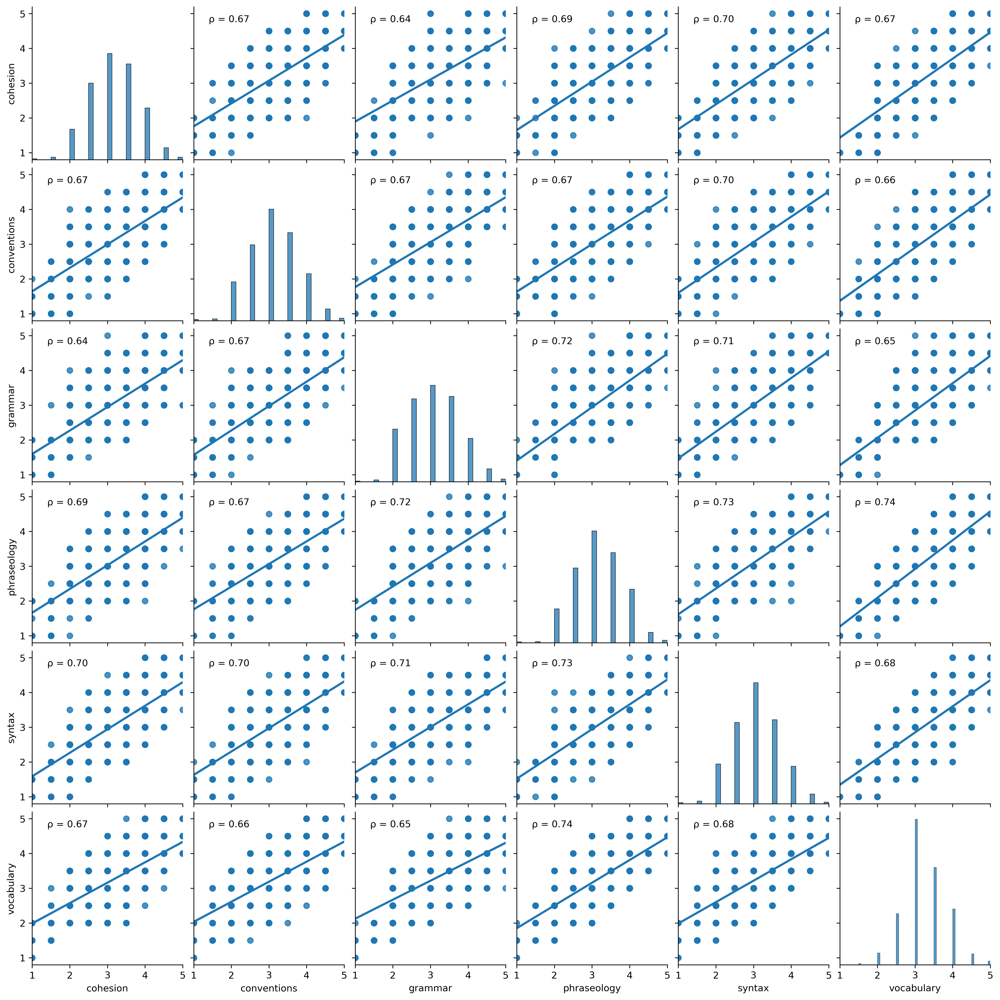

In [12]:
g = sns.pairplot(df[targets], kind='reg')
g.map_offdiag(corrfunc)

<AxesSubplot:>

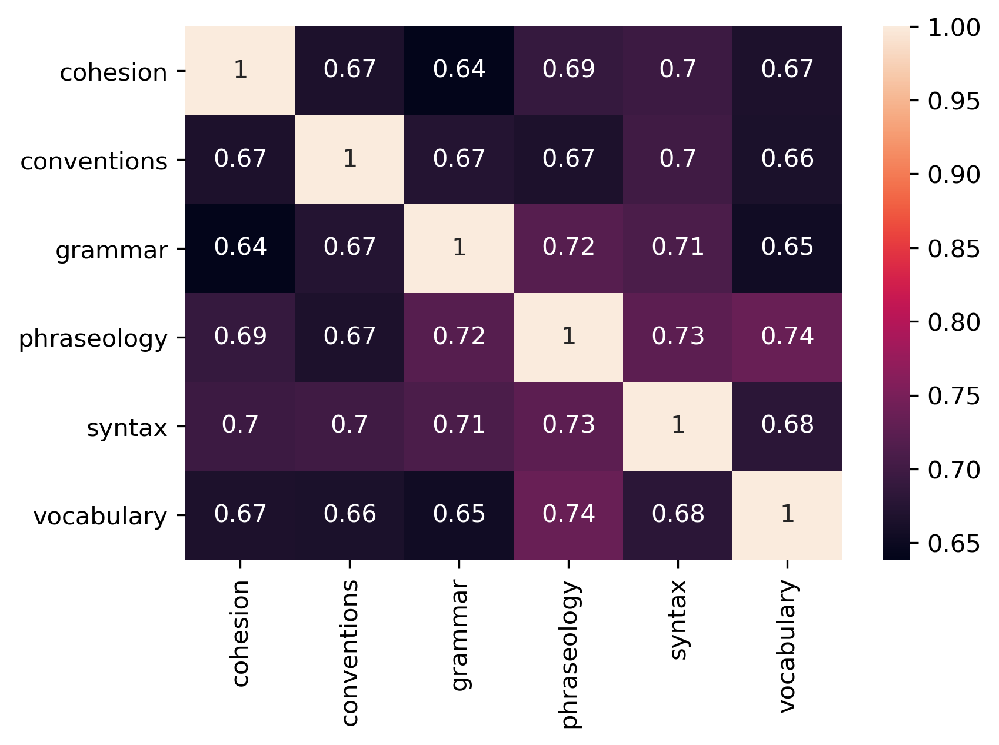

In [13]:
sns.heatmap(df[targets].corr(), annot=True)

In [14]:
feature_generator = FeatureGenerator()

It can take some tike to generate features

In [15]:
large_df = feature_generator.generate_features(df)

In [16]:
features = large_df.columns[8:].to_list()

In [17]:
# too slow to plot
# g = sns.pairplot(large_df, x_vars=targets, y_vars=features, kind='reg')
# g.map(corrfunc)

<AxesSubplot:>

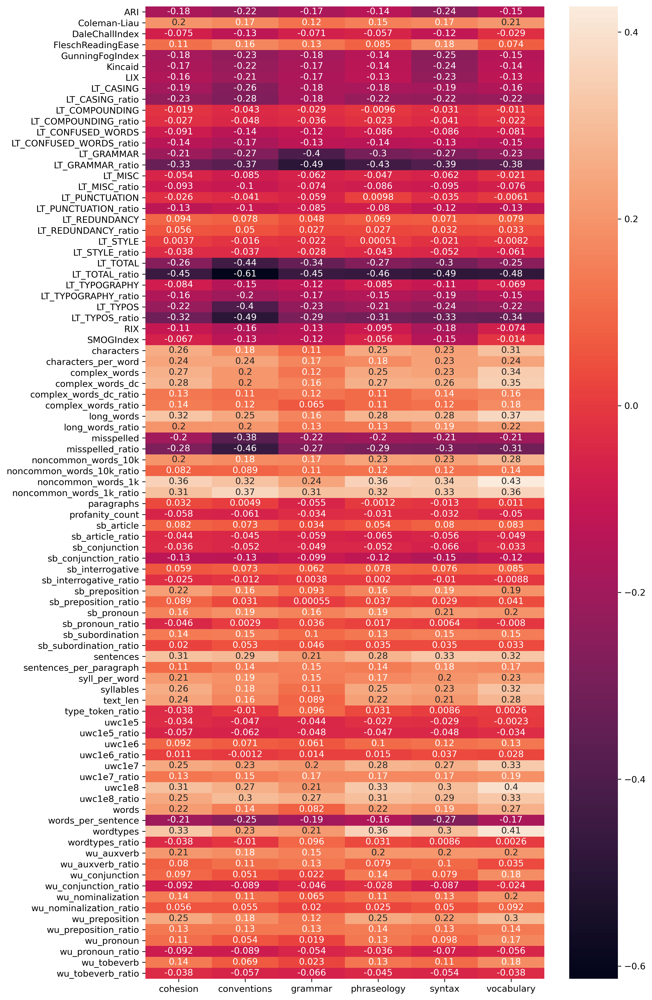

In [18]:
fig, ax = plt.subplots(figsize=(10, 20))
sns.heatmap(large_df[targets + features].corr().iloc[len(targets):, :len(targets)], annot=True, ax=ax)

<AxesSubplot:>

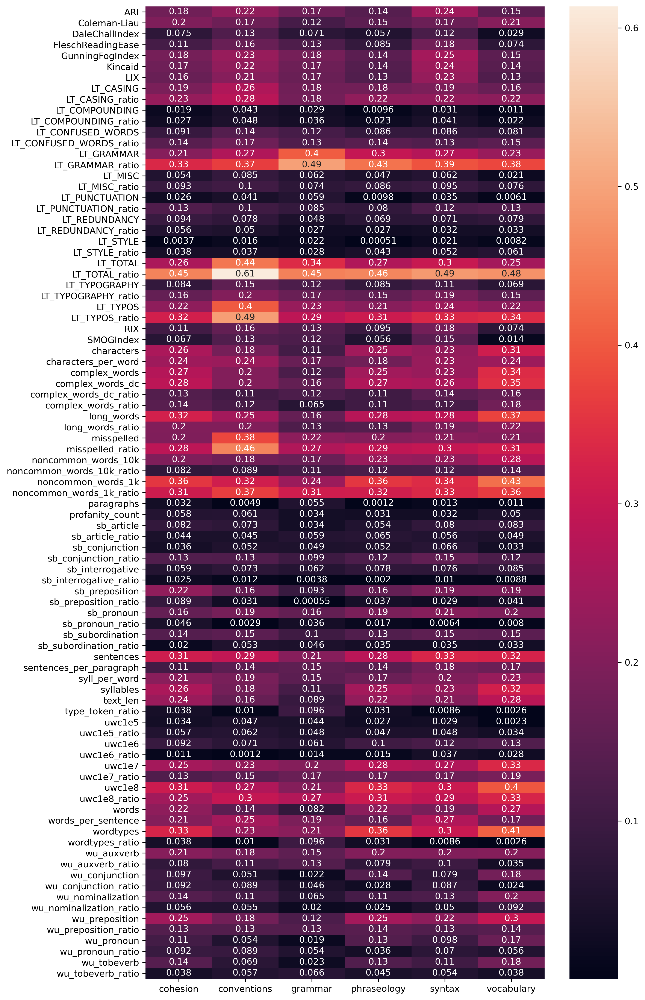

In [19]:
# abs heatmap
fig, ax = plt.subplots(figsize=(10, 20))
sns.heatmap(large_df[targets + features].corr().iloc[len(targets):, :len(targets)].abs(), annot=True, ax=ax)

In [20]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.preprocessing import Normalizer, StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA

In [21]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import ElasticNet
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.multioutput import MultiOutputRegressor

In [22]:
def MCRMSE(a, b):
    return (((a - b)**2).mean(axis=0)**0.5).mean()

from sklearn.metrics import make_scorer
mcrmse_score = make_scorer(MCRMSE, greater_is_better=False) #same as scoring='neg_root_mean_squared_error'

In [23]:
scores = {}

In [24]:
n_splits = 5

In [25]:
score = -cross_val_score(estimator=LinearRegression(),
                        X=large_df[features],
                        y=large_df[targets],
                        scoring='neg_root_mean_squared_error',
                        cv=n_splits,)

In [26]:
score.mean()

0.5142729068947045

In [27]:
scores['linreg'] = score.mean()

In [28]:
score = -cross_val_score(estimator=make_pipeline(Normalizer(), LinearRegression()),
                        X=large_df[features],
                        y=large_df[targets],
                        scoring='neg_root_mean_squared_error',
                        cv=n_splits,)

In [29]:
score.mean()

0.5437523564342885

In [30]:
scores['norm_linreg'] = score.mean()

In [148]:
score = -cross_val_score(estimator=make_pipeline(StandardScaler(), LinearRegression()),
                        X=large_df[features],
                        y=large_df[targets],
                        scoring='neg_root_mean_squared_error',
                        cv=n_splits,)

In [149]:
score.mean()

0.5142934835200982

In [150]:
scores['std_linreg'] = score.mean()

In [51]:
pca = make_pipeline(StandardScaler(), PCA(n_components=0.99))
pca.fit(large_df[features])

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('pca', PCA(n_components=0.99))])

In [52]:
len(pca['pca'].explained_variance_ratio_)

56

In [57]:
scores['std_pca_linreg'] = -cross_val_score(estimator=make_pipeline(StandardScaler(),
                                                                    PCA(n_components=50),
                                                                    LinearRegression()),
                        X=large_df[features],
                        y=large_df[targets],
                        scoring='neg_root_mean_squared_error',
                        cv=n_splits,).mean()

In [58]:
scores['std_pca_linreg']

0.5157124728067435

In [62]:
# convergence issues
# gs_elastic = GridSearchCV(estimator=Pipeline([('std', StandardScaler()),
#                                               ('en', ElasticNet(random_state=42, max_iter=2000))]),
#                      param_grid={"en__alpha": [0.1, 1, 10], 'en__l1_ratio':[0, 0.25, 0.5, 0.75, 1]},
#                      scoring='neg_root_mean_squared_error',
#                      cv=n_splits)
# gs_elastic.fit(X=large_df[features], y=large_df[targets])

In [77]:
# gs_elastic.best_estimator_

Pipeline(steps=[('std', StandardScaler()),
                ('en',
                 ElasticNet(alpha=0.1, l1_ratio=0, max_iter=2000,
                            random_state=42))])

In [79]:
# scores['gs_elastic'] = -gs_elastic.best_score_

In [60]:
score = -cross_val_score(estimator=RandomForestRegressor(max_depth=5),
                        X=large_df[features],
                        y=large_df[targets],
                        scoring='neg_root_mean_squared_error',
                        cv=n_splits,)

In [61]:
score.mean()

0.5155774012600661

In [63]:
gs_rf = GridSearchCV(estimator=RandomForestRegressor(),
                     param_grid={"max_depth": [10, 12, 14]},
                     scoring='neg_root_mean_squared_error',
                     cv=n_splits)
gs_rf.fit(X=large_df[features], y=large_df[targets])

GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid={'max_depth': [10, 12, 14]},
             scoring='neg_root_mean_squared_error')

In [64]:
gs_rf.best_estimator_

RandomForestRegressor(max_depth=12)

In [65]:
-gs_rf.best_score_

0.508217402400264

In [66]:
scores['gs_rf'] = -gs_rf.best_score_

In [67]:
score = -cross_val_score(estimator=XGBRegressor(max_depth=5),
                        X=large_df[features],
                        y=large_df[targets],
                        scoring='neg_root_mean_squared_error',
                        cv=n_splits,)

In [68]:
score.mean()

0.5373909858543091

In [69]:
X_train, X_val, y_train, y_val = train_test_split(large_df[features].copy(),
                                                  large_df[targets].copy(),
                                                  test_size=0.2,
                                                  random_state=42,
                                                  )

In [70]:
gs_xgb = GridSearchCV(estimator=XGBRegressor(early_stopping_rounds=10, n_estimators=100, random_seed=42),
                     param_grid={"max_depth": [2, 3, 4], 'learning_rate': [0.05, 0.1, 0.5]},
                     scoring='neg_root_mean_squared_error',
                     cv=n_splits)
gs_xgb.fit(X=X_train[features], y=y_train[targets], eval_set=[(X_val, y_val)])

[12:22:15] WARNING: ../src/learner.cc:627: 
Parameters: { "random_seed" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[0]	validation_0-rmse:2.55027
[1]	validation_0-rmse:2.42886
[2]	validation_0-rmse:2.31374
[3]	validation_0-rmse:2.20489
[4]	validation_0-rmse:2.10155
[5]	validation_0-rmse:2.00369
[6]	validation_0-rmse:1.91128
[7]	validation_0-rmse:1.82367
[8]	validation_0-rmse:1.74101
[9]	validation_0-rmse:1.66270
[10]	validation_0-rmse:1.58852
[11]	validation_0-rmse:1.51847
[12]	validation_0-rmse:1.45237
[13]	validation_0-rmse:1.38994
[14]	validation_0-rmse:1.33099
[15]	validation_0-rmse:1.27545
[16]	validation_0-rmse:1.22303
[17]	validation_0-rmse:1.17375
[18]	validation_0-rmse:1.12758
[19]	validation_0-rmse:1.08396
[20]	validation_0-rmse:1.043

[31]	validation_0-rmse:0.73618
[32]	validation_0-rmse:0.71822
[33]	validation_0-rmse:0.70153
[34]	validation_0-rmse:0.68635
[35]	validation_0-rmse:0.67201
[36]	validation_0-rmse:0.65890
[37]	validation_0-rmse:0.64685
[38]	validation_0-rmse:0.63555
[39]	validation_0-rmse:0.62516
[40]	validation_0-rmse:0.61568
[41]	validation_0-rmse:0.60702
[42]	validation_0-rmse:0.59899
[43]	validation_0-rmse:0.59165
[44]	validation_0-rmse:0.58482
[45]	validation_0-rmse:0.57857
[46]	validation_0-rmse:0.57291
[47]	validation_0-rmse:0.56765
[48]	validation_0-rmse:0.56286
[49]	validation_0-rmse:0.55837
[50]	validation_0-rmse:0.55444
[51]	validation_0-rmse:0.55072
[52]	validation_0-rmse:0.54746
[53]	validation_0-rmse:0.54428
[54]	validation_0-rmse:0.54148
[55]	validation_0-rmse:0.53884
[56]	validation_0-rmse:0.53648
[57]	validation_0-rmse:0.53427
[58]	validation_0-rmse:0.53218
[59]	validation_0-rmse:0.53038
[60]	validation_0-rmse:0.52864
[61]	validation_0-rmse:0.52726
[62]	validation_0-rmse:0.52586
[63]	val

[73]	validation_0-rmse:0.51405
[74]	validation_0-rmse:0.51355
[75]	validation_0-rmse:0.51312
[76]	validation_0-rmse:0.51264
[77]	validation_0-rmse:0.51218
[78]	validation_0-rmse:0.51175
[79]	validation_0-rmse:0.51131
[80]	validation_0-rmse:0.51089
[81]	validation_0-rmse:0.51059
[82]	validation_0-rmse:0.51028
[83]	validation_0-rmse:0.50994
[84]	validation_0-rmse:0.50967
[85]	validation_0-rmse:0.50934
[86]	validation_0-rmse:0.50908
[87]	validation_0-rmse:0.50887
[88]	validation_0-rmse:0.50859
[89]	validation_0-rmse:0.50836
[90]	validation_0-rmse:0.50810
[91]	validation_0-rmse:0.50793
[92]	validation_0-rmse:0.50770
[93]	validation_0-rmse:0.50752
[94]	validation_0-rmse:0.50737
[95]	validation_0-rmse:0.50729
[96]	validation_0-rmse:0.50715
[97]	validation_0-rmse:0.50694
[98]	validation_0-rmse:0.50682
[99]	validation_0-rmse:0.50667
[12:22:23] WARNING: ../src/learner.cc:627: 
Parameters: { "random_seed" } might not be used.

  This could be a false alarm, with some parameters getting used by l

[3]	validation_0-rmse:2.20502
[4]	validation_0-rmse:2.10180
[5]	validation_0-rmse:2.00386
[6]	validation_0-rmse:1.91121
[7]	validation_0-rmse:1.82367
[8]	validation_0-rmse:1.74054
[9]	validation_0-rmse:1.66219
[10]	validation_0-rmse:1.58791
[11]	validation_0-rmse:1.51776
[12]	validation_0-rmse:1.45149
[13]	validation_0-rmse:1.38875
[14]	validation_0-rmse:1.32970
[15]	validation_0-rmse:1.27389
[16]	validation_0-rmse:1.22132
[17]	validation_0-rmse:1.17185
[18]	validation_0-rmse:1.12544
[19]	validation_0-rmse:1.08174
[20]	validation_0-rmse:1.04057
[21]	validation_0-rmse:1.00204
[22]	validation_0-rmse:0.96573
[23]	validation_0-rmse:0.93174
[24]	validation_0-rmse:0.89977
[25]	validation_0-rmse:0.87023
[26]	validation_0-rmse:0.84232
[27]	validation_0-rmse:0.81635
[28]	validation_0-rmse:0.79220
[29]	validation_0-rmse:0.76963
[30]	validation_0-rmse:0.74884
[31]	validation_0-rmse:0.72941
[32]	validation_0-rmse:0.71141
[33]	validation_0-rmse:0.69472
[34]	validation_0-rmse:0.67920
[35]	validation

[45]	validation_0-rmse:0.56792
[46]	validation_0-rmse:0.56216
[47]	validation_0-rmse:0.55696
[48]	validation_0-rmse:0.55224
[49]	validation_0-rmse:0.54799
[50]	validation_0-rmse:0.54402
[51]	validation_0-rmse:0.54041
[52]	validation_0-rmse:0.53712
[53]	validation_0-rmse:0.53419
[54]	validation_0-rmse:0.53144
[55]	validation_0-rmse:0.52884
[56]	validation_0-rmse:0.52660
[57]	validation_0-rmse:0.52453
[58]	validation_0-rmse:0.52265
[59]	validation_0-rmse:0.52094
[60]	validation_0-rmse:0.51942
[61]	validation_0-rmse:0.51803
[62]	validation_0-rmse:0.51674
[63]	validation_0-rmse:0.51550
[64]	validation_0-rmse:0.51437
[65]	validation_0-rmse:0.51340
[66]	validation_0-rmse:0.51243
[67]	validation_0-rmse:0.51164
[68]	validation_0-rmse:0.51089
[69]	validation_0-rmse:0.51013
[70]	validation_0-rmse:0.50941
[71]	validation_0-rmse:0.50881
[72]	validation_0-rmse:0.50833
[73]	validation_0-rmse:0.50781
[74]	validation_0-rmse:0.50739
[75]	validation_0-rmse:0.50703
[76]	validation_0-rmse:0.50665
[77]	val

[87]	validation_0-rmse:0.50486
[88]	validation_0-rmse:0.50472
[89]	validation_0-rmse:0.50457
[90]	validation_0-rmse:0.50446
[91]	validation_0-rmse:0.50441
[92]	validation_0-rmse:0.50433
[93]	validation_0-rmse:0.50432
[94]	validation_0-rmse:0.50426
[95]	validation_0-rmse:0.50409
[96]	validation_0-rmse:0.50407
[97]	validation_0-rmse:0.50405
[98]	validation_0-rmse:0.50409
[99]	validation_0-rmse:0.50398
[12:22:37] WARNING: ../src/learner.cc:627: 
Parameters: { "random_seed" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[0]	validation_0-rmse:2.55042
[1]	validation_0-rmse:2.42904
[2]	validation_0-rmse:2.31408
[3]	validation_0-rmse:2.20508
[4]	validation_0-rmse:2.10190
[5]	validation_0-rmse:2.00413
[6]	validation_0-rmse:1.91156
[7]	validation_0-rmse:1.8

[18]	validation_0-rmse:1.12225
[19]	validation_0-rmse:1.07826
[20]	validation_0-rmse:1.03685
[21]	validation_0-rmse:0.99785
[22]	validation_0-rmse:0.96141
[23]	validation_0-rmse:0.92723
[24]	validation_0-rmse:0.89532
[25]	validation_0-rmse:0.86555
[26]	validation_0-rmse:0.83758
[27]	validation_0-rmse:0.81138
[28]	validation_0-rmse:0.78699
[29]	validation_0-rmse:0.76452
[30]	validation_0-rmse:0.74347
[31]	validation_0-rmse:0.72401
[32]	validation_0-rmse:0.70580
[33]	validation_0-rmse:0.68898
[34]	validation_0-rmse:0.67344
[35]	validation_0-rmse:0.65894
[36]	validation_0-rmse:0.64573
[37]	validation_0-rmse:0.63351
[38]	validation_0-rmse:0.62204
[39]	validation_0-rmse:0.61174
[40]	validation_0-rmse:0.60225
[41]	validation_0-rmse:0.59336
[42]	validation_0-rmse:0.58534
[43]	validation_0-rmse:0.57810
[44]	validation_0-rmse:0.57132
[45]	validation_0-rmse:0.56510
[46]	validation_0-rmse:0.55936
[47]	validation_0-rmse:0.55427
[48]	validation_0-rmse:0.54947
[49]	validation_0-rmse:0.54520
[50]	val

[60]	validation_0-rmse:0.50645
[61]	validation_0-rmse:0.50628
[62]	validation_0-rmse:0.50595
[63]	validation_0-rmse:0.50597
[64]	validation_0-rmse:0.50604
[65]	validation_0-rmse:0.50594
[66]	validation_0-rmse:0.50585
[67]	validation_0-rmse:0.50574
[68]	validation_0-rmse:0.50564
[69]	validation_0-rmse:0.50549
[70]	validation_0-rmse:0.50550
[71]	validation_0-rmse:0.50548
[72]	validation_0-rmse:0.50536
[73]	validation_0-rmse:0.50541
[74]	validation_0-rmse:0.50550
[75]	validation_0-rmse:0.50550
[76]	validation_0-rmse:0.50538
[77]	validation_0-rmse:0.50533
[78]	validation_0-rmse:0.50541
[79]	validation_0-rmse:0.50526
[80]	validation_0-rmse:0.50507
[81]	validation_0-rmse:0.50503
[82]	validation_0-rmse:0.50501
[83]	validation_0-rmse:0.50506
[84]	validation_0-rmse:0.50496
[85]	validation_0-rmse:0.50495
[86]	validation_0-rmse:0.50486
[87]	validation_0-rmse:0.50479
[88]	validation_0-rmse:0.50475
[89]	validation_0-rmse:0.50467
[90]	validation_0-rmse:0.50476
[91]	validation_0-rmse:0.50476
[92]	val

[0]	validation_0-rmse:2.42256
[1]	validation_0-rmse:2.19404
[2]	validation_0-rmse:1.98905
[3]	validation_0-rmse:1.80633
[4]	validation_0-rmse:1.64316
[5]	validation_0-rmse:1.49793
[6]	validation_0-rmse:1.36869
[7]	validation_0-rmse:1.25376
[8]	validation_0-rmse:1.15216
[9]	validation_0-rmse:1.06311
[10]	validation_0-rmse:0.98450
[11]	validation_0-rmse:0.91522
[12]	validation_0-rmse:0.85506
[13]	validation_0-rmse:0.80287
[14]	validation_0-rmse:0.75758
[15]	validation_0-rmse:0.71890
[16]	validation_0-rmse:0.68581
[17]	validation_0-rmse:0.65748
[18]	validation_0-rmse:0.63366
[19]	validation_0-rmse:0.61335
[20]	validation_0-rmse:0.59617
[21]	validation_0-rmse:0.58171
[22]	validation_0-rmse:0.56973
[23]	validation_0-rmse:0.55993
[24]	validation_0-rmse:0.55145
[25]	validation_0-rmse:0.54454
[26]	validation_0-rmse:0.53869
[27]	validation_0-rmse:0.53390
[28]	validation_0-rmse:0.52989
[29]	validation_0-rmse:0.52639
[30]	validation_0-rmse:0.52346
[31]	validation_0-rmse:0.52100
[32]	validation_0-

[63]	validation_0-rmse:0.50453
[64]	validation_0-rmse:0.50436
[65]	validation_0-rmse:0.50445
[66]	validation_0-rmse:0.50449
[67]	validation_0-rmse:0.50455
[68]	validation_0-rmse:0.50466
[69]	validation_0-rmse:0.50481
[70]	validation_0-rmse:0.50476
[71]	validation_0-rmse:0.50474
[72]	validation_0-rmse:0.50473
[73]	validation_0-rmse:0.50469
[12:22:53] WARNING: ../src/learner.cc:627: 
Parameters: { "random_seed" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[0]	validation_0-rmse:2.42285
[1]	validation_0-rmse:2.19394
[2]	validation_0-rmse:1.98862
[3]	validation_0-rmse:1.80552
[4]	validation_0-rmse:1.64197
[5]	validation_0-rmse:1.49597
[6]	validation_0-rmse:1.36613
[7]	validation_0-rmse:1.25122
[8]	validation_0-rmse:1.14914
[9]	validation_0-rmse:1.058

[33]	validation_0-rmse:0.51185
[34]	validation_0-rmse:0.51043
[35]	validation_0-rmse:0.50937
[36]	validation_0-rmse:0.50856
[37]	validation_0-rmse:0.50761
[38]	validation_0-rmse:0.50690
[39]	validation_0-rmse:0.50643
[40]	validation_0-rmse:0.50610
[41]	validation_0-rmse:0.50568
[42]	validation_0-rmse:0.50526
[43]	validation_0-rmse:0.50490
[44]	validation_0-rmse:0.50446
[45]	validation_0-rmse:0.50417
[46]	validation_0-rmse:0.50407
[47]	validation_0-rmse:0.50408
[48]	validation_0-rmse:0.50378
[49]	validation_0-rmse:0.50371
[50]	validation_0-rmse:0.50355
[51]	validation_0-rmse:0.50333
[52]	validation_0-rmse:0.50321
[53]	validation_0-rmse:0.50320
[54]	validation_0-rmse:0.50300
[55]	validation_0-rmse:0.50267
[56]	validation_0-rmse:0.50254
[57]	validation_0-rmse:0.50244
[58]	validation_0-rmse:0.50250
[59]	validation_0-rmse:0.50243
[60]	validation_0-rmse:0.50257
[61]	validation_0-rmse:0.50253
[62]	validation_0-rmse:0.50248
[63]	validation_0-rmse:0.50248
[64]	validation_0-rmse:0.50236
[65]	val

[57]	validation_0-rmse:0.50665
[58]	validation_0-rmse:0.50668
[59]	validation_0-rmse:0.50648
[60]	validation_0-rmse:0.50652
[61]	validation_0-rmse:0.50659
[62]	validation_0-rmse:0.50657
[63]	validation_0-rmse:0.50657
[64]	validation_0-rmse:0.50662
[65]	validation_0-rmse:0.50658
[66]	validation_0-rmse:0.50685
[67]	validation_0-rmse:0.50691
[68]	validation_0-rmse:0.50699
[69]	validation_0-rmse:0.50703
[12:23:02] WARNING: ../src/learner.cc:627: 
Parameters: { "random_seed" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[0]	validation_0-rmse:2.42211
[1]	validation_0-rmse:2.19298
[2]	validation_0-rmse:1.98813
[3]	validation_0-rmse:1.80490
[4]	validation_0-rmse:1.64124
[5]	validation_0-rmse:1.49505
[6]	validation_0-rmse:1.36563
[7]	validation_0-rmse:1.2

[9]	validation_0-rmse:0.51123
[10]	validation_0-rmse:0.51041
[11]	validation_0-rmse:0.51076
[12]	validation_0-rmse:0.50989
[13]	validation_0-rmse:0.50929
[14]	validation_0-rmse:0.50944
[15]	validation_0-rmse:0.50931
[16]	validation_0-rmse:0.50958
[17]	validation_0-rmse:0.51019
[18]	validation_0-rmse:0.51018
[19]	validation_0-rmse:0.50995
[20]	validation_0-rmse:0.50951
[21]	validation_0-rmse:0.50946
[22]	validation_0-rmse:0.50934
[12:23:06] WARNING: ../src/learner.cc:627: 
Parameters: { "random_seed" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[0]	validation_0-rmse:1.42335
[1]	validation_0-rmse:0.85332
[2]	validation_0-rmse:0.62827
[3]	validation_0-rmse:0.55174
[4]	validation_0-rmse:0.52906
[5]	validation_0-rmse:0.52085
[6]	validation_0-rmse:0.5

[16]	validation_0-rmse:0.53399
[12:23:09] WARNING: ../src/learner.cc:627: 
Parameters: { "random_seed" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[0]	validation_0-rmse:1.41934
[1]	validation_0-rmse:0.84506
[2]	validation_0-rmse:0.61804
[3]	validation_0-rmse:0.54535
[4]	validation_0-rmse:0.52564
[5]	validation_0-rmse:0.52074
[6]	validation_0-rmse:0.52121
[7]	validation_0-rmse:0.51989
[8]	validation_0-rmse:0.52133
[9]	validation_0-rmse:0.52203
[10]	validation_0-rmse:0.52371
[11]	validation_0-rmse:0.52460
[12]	validation_0-rmse:0.52459
[13]	validation_0-rmse:0.52614
[14]	validation_0-rmse:0.52698
[15]	validation_0-rmse:0.52803
[16]	validation_0-rmse:0.52802
[12:23:10] WARNING: ../src/learner.cc:627: 
Parameters: { "random_seed" } might not be use

GridSearchCV(cv=5,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    callbacks=None, colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None,
                                    early_stopping_rounds=10,
                                    enable_categorical=False, eval_metric=None,
                                    gamma=None, gpu_id=None, grow_policy=None,
                                    importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, max_bin=None,
                                    max_cat_to_onehot=None, max_delta_step=None,
                                    max_depth=None, max_leaves=None,
                                    min_child_weight=None, missing=nan,
                                    monotone_constraints=None, n_estimators=100,
  

In [71]:
gs_xgb.best_estimator_

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=10, enable_categorical=False,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.1, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=2, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=100, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_seed=42,
             random_state=0, reg_alpha=0, ...)

In [72]:
-gs_xgb.best_score_

0.5054855110305354

In [73]:
scores['gs_xgb'] = -gs_xgb.best_score_

In [74]:
gs_xgb.best_params_

{'learning_rate': 0.1, 'max_depth': 2}

now we need to figure out what's the best n_estimators for XGBRegressor

In [75]:
gs_xgb.cv_results_

{'mean_fit_time': array([1.53424172, 1.73076859, 2.34323378, 1.36036153, 1.4559104 ,
        1.52390699, 0.35283556, 0.33992057, 0.40432711]),
 'std_fit_time': array([0.31011578, 0.06402034, 0.19074717, 0.17644635, 0.16502367,
        0.12443136, 0.07775627, 0.03287754, 0.04194298]),
 'mean_score_time': array([0.01141958, 0.00706677, 0.00905356, 0.00577888, 0.0100955 ,
        0.00875692, 0.00763683, 0.00682459, 0.00440617]),
 'std_score_time': array([0.00641072, 0.00269545, 0.00584055, 0.00334   , 0.00508032,
        0.00372013, 0.00454331, 0.00307704, 0.00079342]),
 'param_learning_rate': masked_array(data=[0.05, 0.05, 0.05, 0.1, 0.1, 0.1, 0.5, 0.5, 0.5],
              mask=[False, False, False, False, False, False, False, False,
                    False],
        fill_value='?',
             dtype=object),
 'param_max_depth': masked_array(data=[2, 3, 4, 2, 3, 4, 2, 3, 4],
              mask=[False, False, False, False, False, False, False, False,
                    False],
       

In [76]:
def f(max_depth, learning_rate):
    print(learning_rate, max_depth)
f(**gs_xgb.best_params_)

0.1 2


In [77]:
xgb_reg = XGBRegressor(**gs_xgb.best_params_, early_stopping_rounds=10, n_estimators=100)
xgb_reg.fit(X=X_train[features], y=y_train[targets], eval_set=[(X_val, y_val)])

[0]	validation_0-rmse:2.42269
[1]	validation_0-rmse:2.19404
[2]	validation_0-rmse:1.98930
[3]	validation_0-rmse:1.80627
[4]	validation_0-rmse:1.64299
[5]	validation_0-rmse:1.49774
[6]	validation_0-rmse:1.36828
[7]	validation_0-rmse:1.25396
[8]	validation_0-rmse:1.15252
[9]	validation_0-rmse:1.06286
[10]	validation_0-rmse:0.98432
[11]	validation_0-rmse:0.91547
[12]	validation_0-rmse:0.85539
[13]	validation_0-rmse:0.80381
[14]	validation_0-rmse:0.75873
[15]	validation_0-rmse:0.71995
[16]	validation_0-rmse:0.68683
[17]	validation_0-rmse:0.65862
[18]	validation_0-rmse:0.63479
[19]	validation_0-rmse:0.61450
[20]	validation_0-rmse:0.59765
[21]	validation_0-rmse:0.58317
[22]	validation_0-rmse:0.57128
[23]	validation_0-rmse:0.56106
[24]	validation_0-rmse:0.55280
[25]	validation_0-rmse:0.54589
[26]	validation_0-rmse:0.54005
[27]	validation_0-rmse:0.53525
[28]	validation_0-rmse:0.53097
[29]	validation_0-rmse:0.52729
[30]	validation_0-rmse:0.52445
[31]	validation_0-rmse:0.52178
[32]	validation_0-

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=10, enable_categorical=False,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.1, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=2, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=100, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, ...)

ok let's keep n_estimators=100

In [78]:
from sklearn.ensemble import VotingRegressor

these two cell are basically same

In [80]:
# vote = VotingRegressor(estimators=[
#     ('xgb',  XGBRegressor(**gs_xgb.best_params_, n_estimators=100)),
#     ('linreg', LinearRegression()),
#     ('rf', RandomForestRegressor(**gs_rf.best_params_))
# ])

In [81]:
vote = VotingRegressor(estimators=[
    ('xgb',  XGBRegressor(learning_rate=0.1, max_depth=2, n_estimators=100)),
    ('linreg', LinearRegression()),
    ('rf', RandomForestRegressor(max_depth=12))
])

unfortunately, VotingRegressor does not do multi-target regression

In [83]:
score = -cross_val_score(estimator=vote,
                        X=large_df[features],
                        y=large_df[targets],
                        scoring='neg_root_mean_squared_error',
                        cv=n_splits,)

/usr/lib64/python3.10/site-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 5.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/lib64/python3.10/site-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/lib64/python3.10/site-packages/sklearn/ensemble/_voting.py", line 528, in fit
    y = column_or_1d(y, warn=True)
  File "/usr/lib64/python3.10/site-packages/sklearn/utils/validation.py", line 1038, in column_or_1d
    raise ValueError(
ValueError: y should be a 1d array, got an array of shape (3128, 6) instead.



In [84]:
score = -cross_val_score(estimator=MultiOutputRegressor(vote),
                        X=large_df[features],
                        y=large_df[targets],
                        scoring='neg_root_mean_squared_error',
                        cv=n_splits,)

In [85]:
score.mean()

0.4990967748625292

In [86]:
scores['xgb_linreg_rf'] = score.mean()

In [151]:
scores_df = pd.DataFrame(sorted(scores.items(), key=lambda x: x[1]), columns=['model', 'score'])

In [152]:
scores_df

,model,score
0,xgb_linreg_rf,0.499097
1,gs_xgb,0.505486
2,gs_rf,0.508217
3,linreg,0.514273
4,std_linreg,0.514293
5,std_pca_linreg,0.515712
6,norm_linreg,0.543752


Text(0.5, 0, 'CV score')

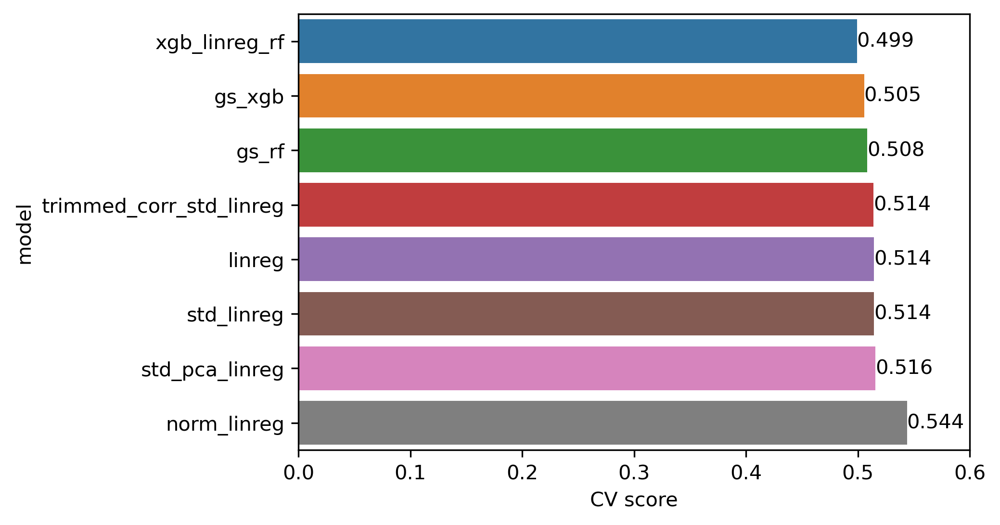

In [163]:
ax = sns.barplot(data=scores_df, x='score', y='model')
for container in ax.containers:
    ax.bar_label(container, fmt='%.3f')
ax.set_xbound(upper=0.6)
ax.set_xlabel("CV score")

In [89]:
final_model = MultiOutputRegressor(vote)
final_model.fit(X=large_df[features], y=large_df[targets])

MultiOutputRegressor(estimator=VotingRegressor(estimators=[('xgb',
                                                            XGBRegressor(base_score=None,
                                                                         booster=None,
                                                                         callbacks=None,
                                                                         colsample_bylevel=None,
                                                                         colsample_bynode=None,
                                                                         colsample_bytree=None,
                                                                         early_stopping_rounds=None,
                                                                         enable_categorical=False,
                                                                         eval_metric=None,
                                                                         gamma=None,
  

In [96]:
from joblib import dump, load
dump(final_model, 'xgb_linreg_rf.joblib')

['xgb_linreg_rf.joblib']

Feature importance

Hmm there is some problem with accessing models inside final voting regressor so we need to train each model separately.

Lots of features are highly correlated, let's drop some of them.
But how can we decide which feature to keep and which to drop?
And if we drop a feature, does it mean we can forget about it in feature importance analysis?

### ATTENTION: this linear regression model is not the same as before!

In [97]:
def trimm_correlated(df_in, threshold):
    df_corr = df_in.corr(method='pearson', min_periods=1)
    df_not_correlated = ~(df_corr.mask(np.tril(np.ones([len(df_corr)]*2, dtype=bool))).abs() > threshold).any()
    un_corr_idx = df_not_correlated.loc[df_not_correlated[df_not_correlated.index] == True].index
    return df_in.columns.difference(un_corr_idx)

In [98]:
trimmed_df = large_df.copy()

In [99]:
trimmed_df = trimmed_df.drop(columns=trimm_correlated(trimmed_df[features], 0.9))

In [100]:
trimmed_df_features = trimmed_df.columns[8:].to_list()

In [101]:
len(features), len(trimmed_df_features)

(89, 70)

In [198]:
print(f"we have dropped {len(features) - len(trimmed_df_features)} highly correlated features")

we have dropped 19 highly correlated features


In [102]:
std_lin_reg = make_pipeline(StandardScaler(), LinearRegression())
std_lin_reg.fit(X=trimmed_df[trimmed_df_features], y=trimmed_df[targets])

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('linearregression', LinearRegression())])

In [157]:
trimmed_corr_std_linreg = -cross_val_score(estimator=make_pipeline(StandardScaler(), LinearRegression()),
                        X=trimmed_df[trimmed_df_features],
                        y=trimmed_df[targets],
                        scoring='neg_root_mean_squared_error',
                        cv=n_splits,).mean()

In [158]:
scores['trimmed_corr_std_linreg'] = trimmed_corr_std_linreg

In [160]:
scores_df = pd.DataFrame(sorted(scores.items(), key=lambda x: x[1]), columns=['model', 'score'])

Text(0.5, 0, 'CV score')

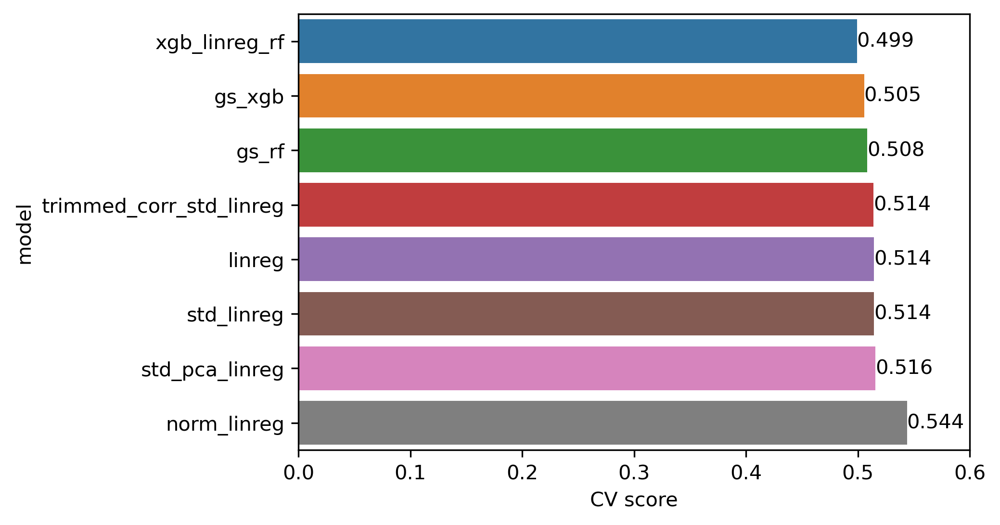

In [162]:
ax = sns.barplot(data=scores_df, x='score', y='model')
for container in ax.containers:
    ax.bar_label(container, fmt='%.3f')
ax.set_xbound(upper=0.6)
ax.set_xlabel("CV score")

In [121]:
lin_reg_feature_imp = pd.DataFrame(data=std_lin_reg['linearregression'].coef_[0], index=trimmed_df_features, columns=['feature importance'])

In [122]:
lin_reg_feature_imp = lin_reg_feature_imp.sort_values(by='feature importance', key=abs)

In [123]:
lin_reg_feature_imp

,feature importance
LT_PUNCTUATION_ratio,-0.000310
sb_article_ratio,0.000542
LT_COMPOUNDING,0.000652
LT_REDUNDANCY,-0.000749
LT_MISC,-0.001949
...,...
LT_TYPOS_ratio,0.140010
LT_TYPOS,0.287084
wordtypes,0.315935
LT_TOTAL_ratio,-0.347161


Text(0.5, 1.0, 'Top 20 features (linear regression)')

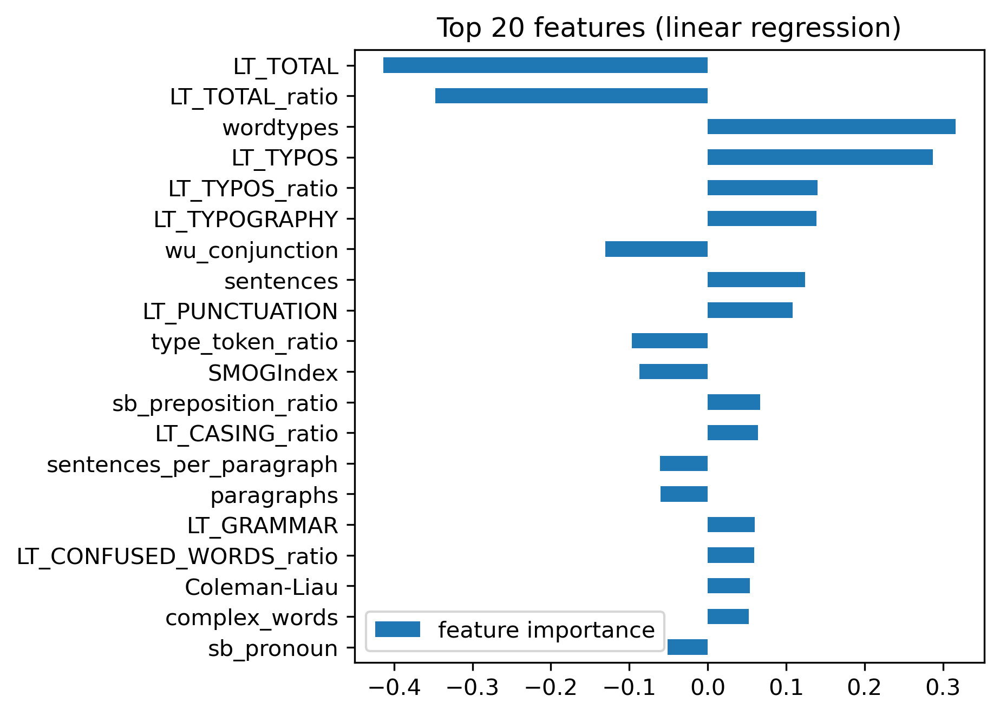

In [124]:
fig, ax = plt.subplots(figsize=(5, 5))
lin_reg_feature_imp[50:].plot.barh(y=0, ax=ax)
ax = plt.gca()
ax.set_title("Top 20 features (linear regression)")

<AxesSubplot:>

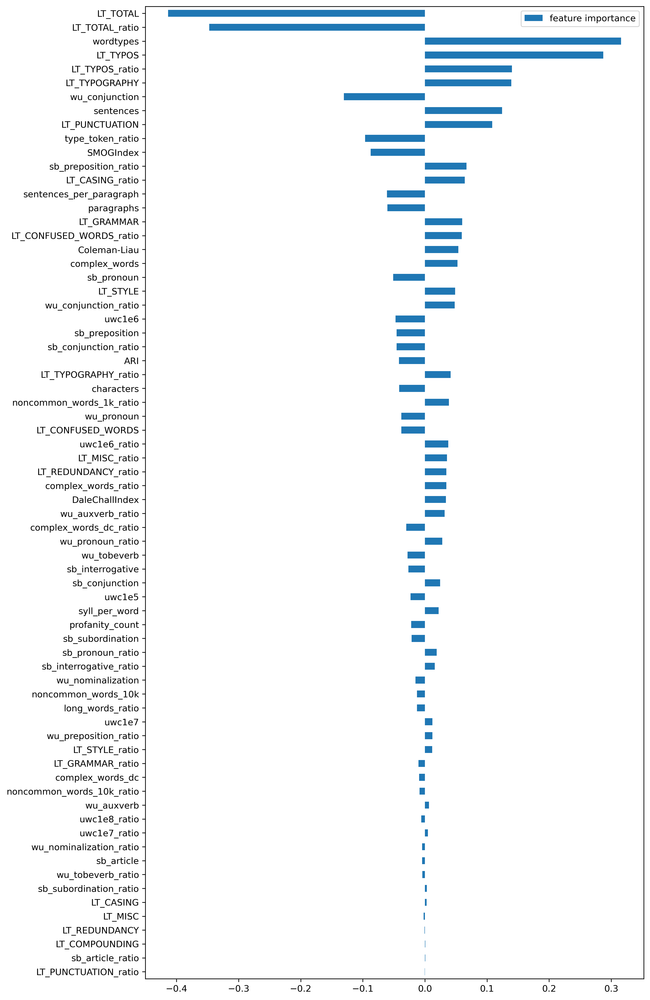

In [125]:
fig, ax = plt.subplots(figsize=(10, 20))
lin_reg_feature_imp.plot.barh(y=0, ax=ax)

Feature importance for random forest
### There are many other ways to study feature importance for random forest
https://towardsdatascience.com/explaining-feature-importance-by-example-of-a-random-forest-d9166011959e

In [108]:
rf_model = RandomForestRegressor(**gs_rf.best_params_)
rf_model.fit(large_df[features], large_df[targets])

RandomForestRegressor(max_depth=12)

In [128]:
rf_feature_imp = pd.DataFrame(data=rf_model.feature_importances_, index=features, columns=['feature importance']).sort_values(by='feature importance', key=abs)

Text(0.5, 1.0, 'Top 10 feature (Random Forest)')

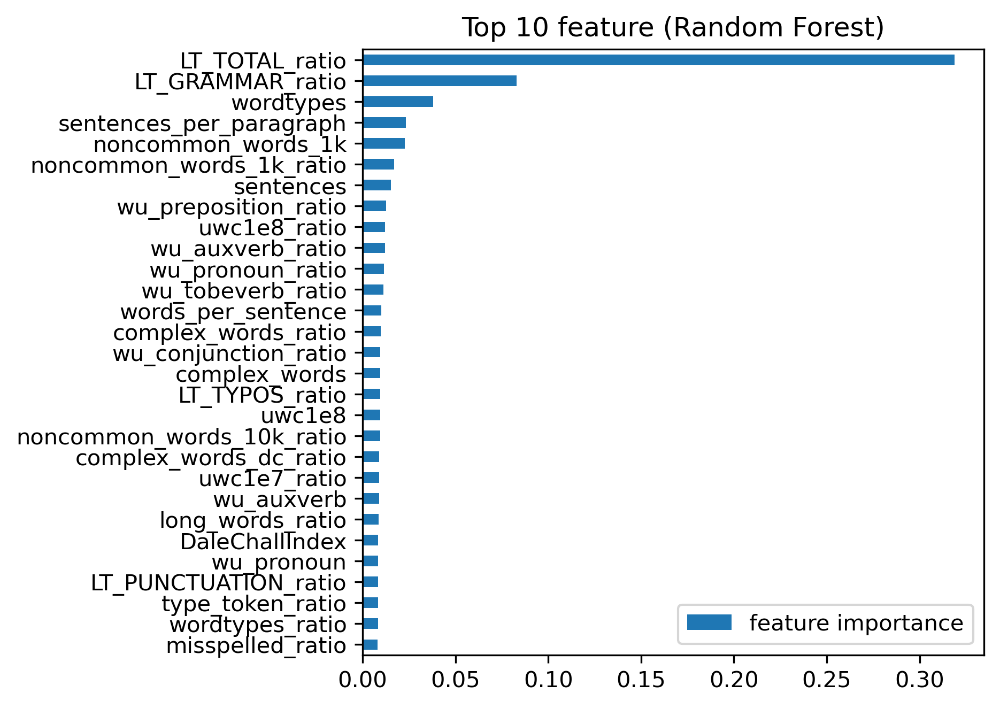

In [129]:
fig, ax = plt.subplots(figsize=(5, 5))
rf_feature_imp[60:].plot.barh(y=0, ax=ax)
ax = plt.gca()
ax.set_title("Top 10 feature (Random Forest)")

<AxesSubplot:>

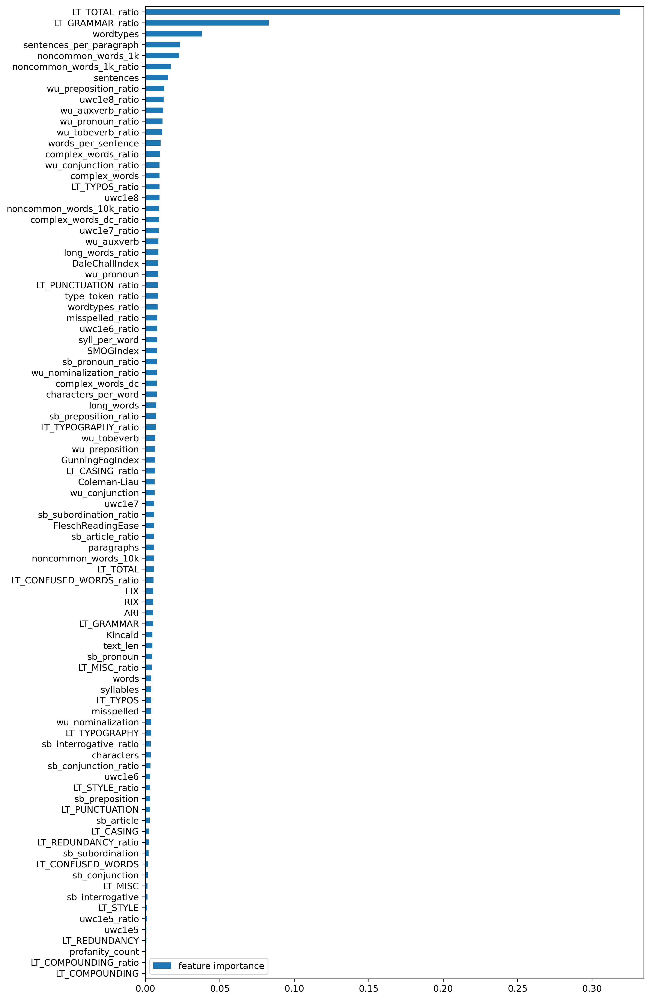

In [130]:
fig, ax = plt.subplots(figsize=(10, 20))
rf_feature_imp.plot.barh(y=0, ax=ax)

feature importance for xgbclassifier

In [131]:
from xgboost import plot_importance

Text(0.5, 1.0, 'XGBClassifier feature importance (top 20, by weight)')

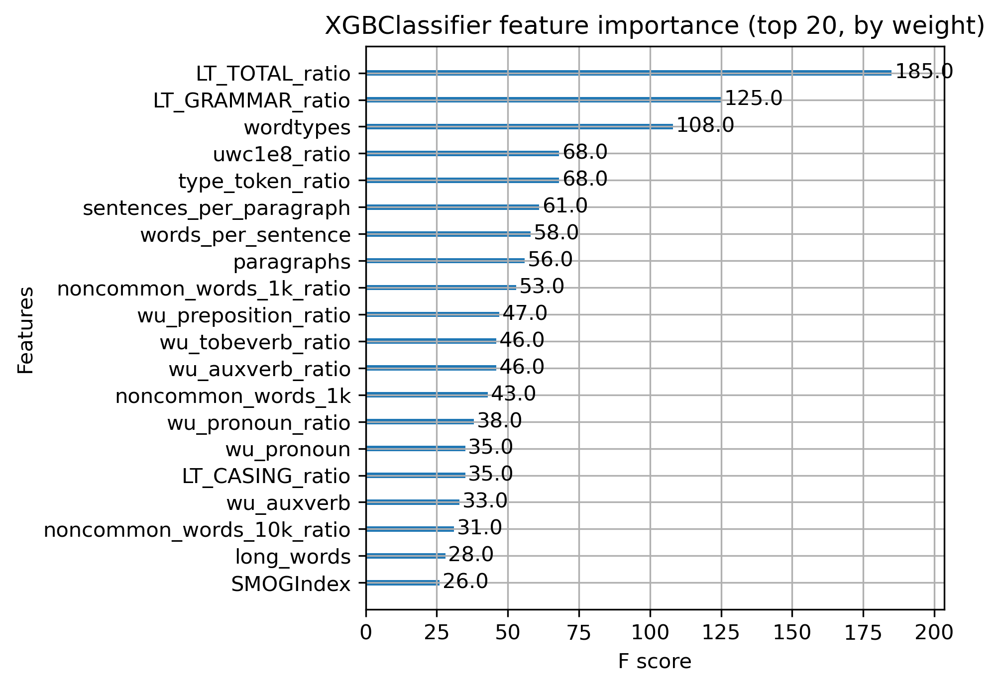

In [140]:
fig, ax = plt.subplots(figsize=(5, 5))
plot_importance(xgb_reg, ax=ax, importance_type='weight', max_num_features=20)
ax.set_title("XGBClassifier feature importance (top 20, by weight)")

<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

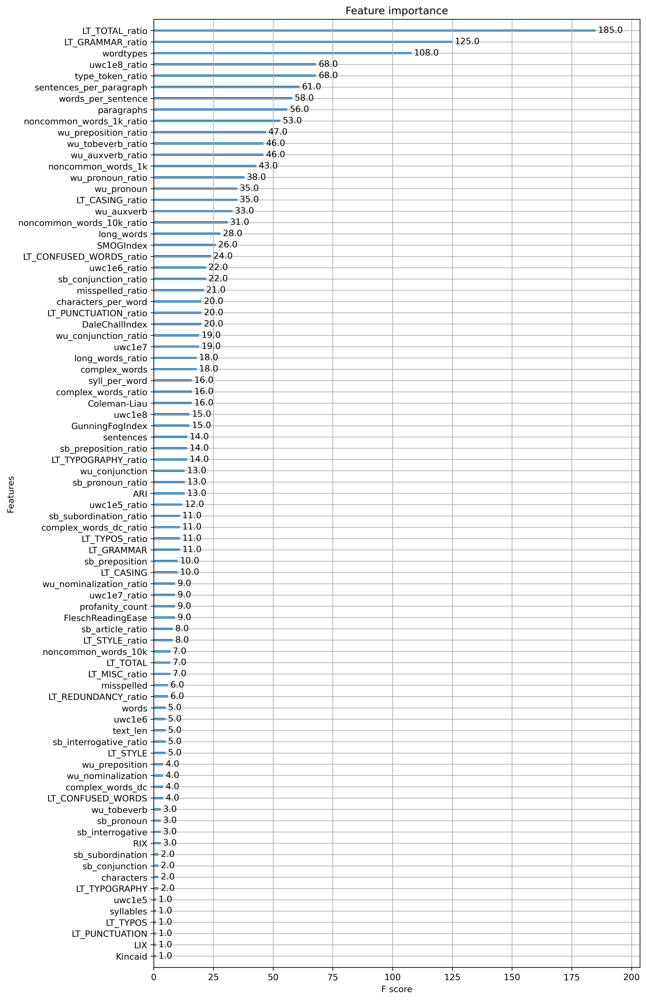

In [132]:
fig, ax = plt.subplots(figsize=(10, 20))
plot_importance(xgb_reg, ax=ax, importance_type='weight')

Text(0.5, 1.0, 'XGBClassifier feature importance (top 20, by gain)')

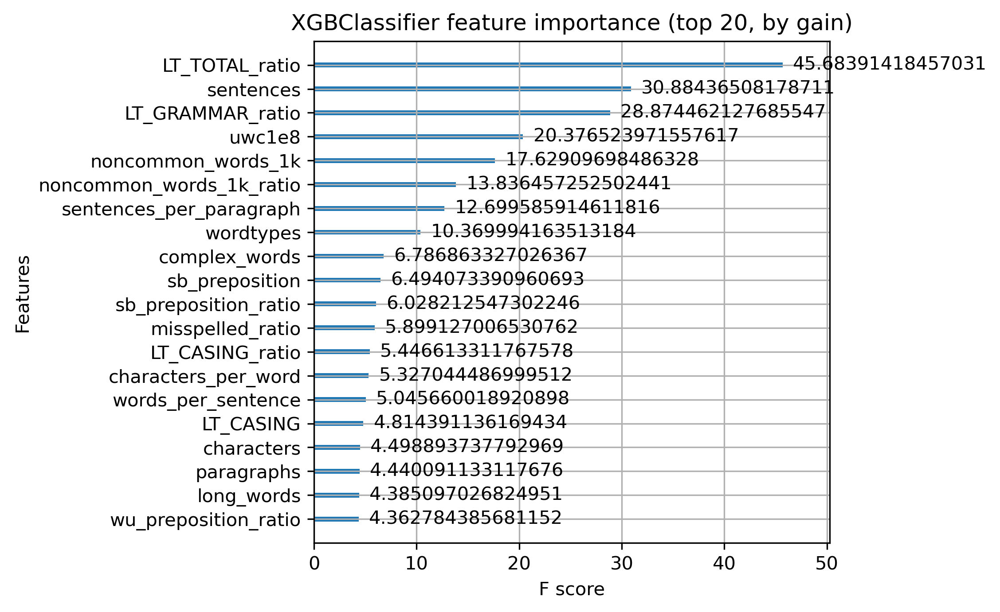

In [143]:
fig, ax = plt.subplots(figsize=(5, 5))
plot_importance(xgb_reg, ax=ax, importance_type='gain', max_num_features=20)
ax.set_title("XGBClassifier feature importance (top 20, by gain)")

<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

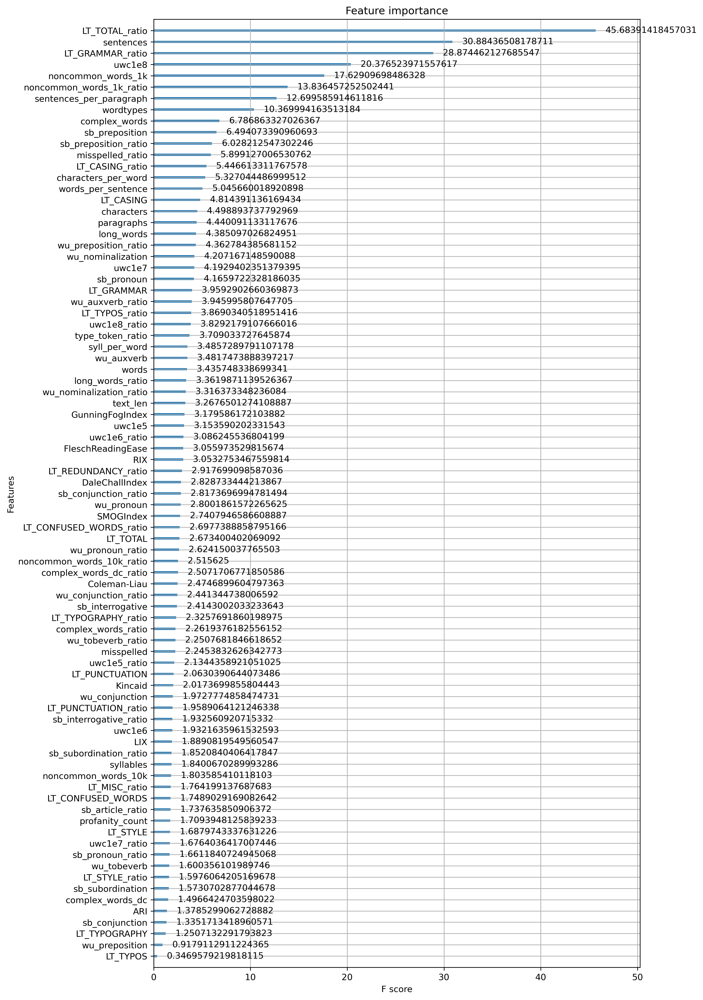

In [136]:
fig, ax = plt.subplots(figsize=(10, 20))
plot_importance(xgb_reg, ax=ax, importance_type='gain')

Text(0.5, 1.0, 'XGBClassifier feature importance (top 20, by cover)')

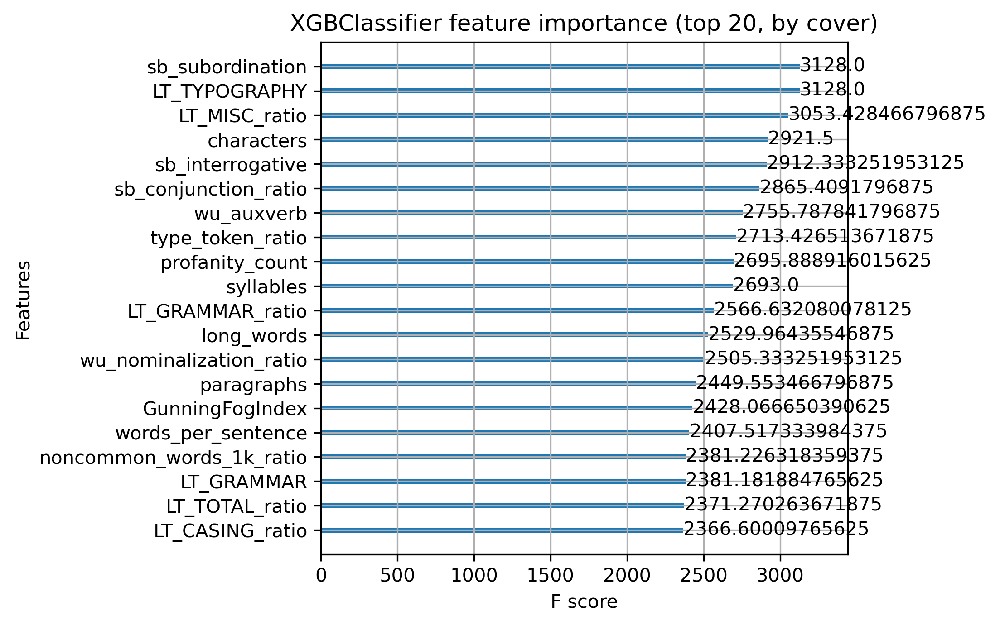

In [144]:
fig, ax = plt.subplots(figsize=(5, 5))
plot_importance(xgb_reg, ax=ax, importance_type='cover', max_num_features=20)
ax.set_title("XGBClassifier feature importance (top 20, by cover)")

<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

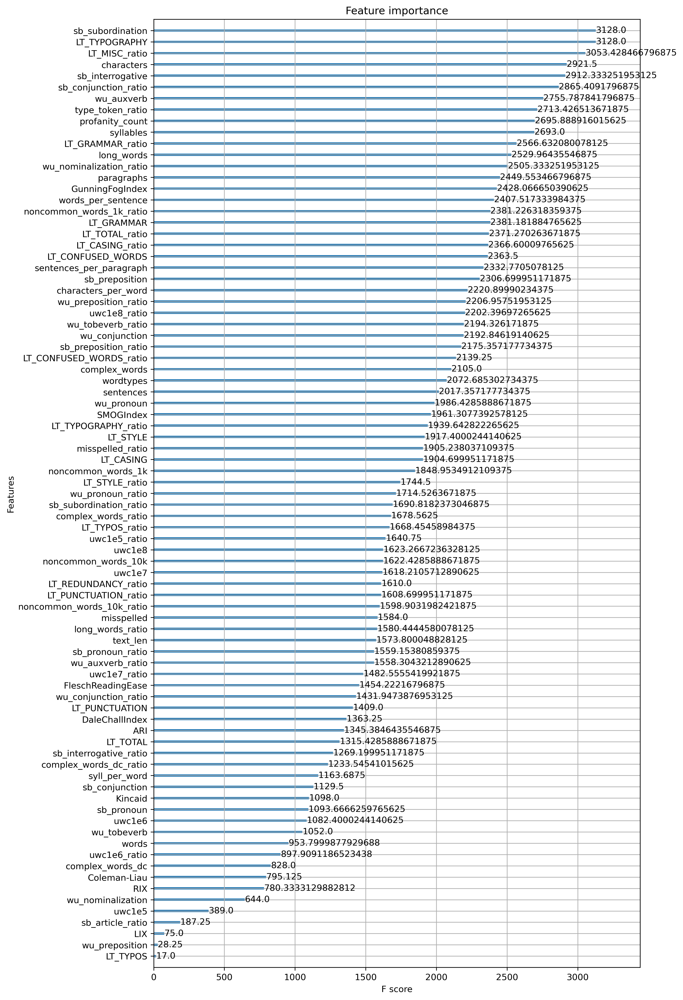

In [138]:
fig, ax = plt.subplots(figsize=(10, 20))
plot_importance(xgb_reg, ax=ax, importance_type='cover')

In [165]:
def clipped_model_predict(X):
    return final_model.predict(X).clip(1, 5)

In [166]:
import shap

First, let's try SHAP analysis for the final model. We select a subset of the data because it takes quite a lot of time to genereta SHAP values.

In [169]:
shap_dataset = large_df.sample(n=100, random_state=42).copy()

In [175]:
explainer = shap.KernelExplainer(clipped_model_predict, shap_dataset[final_model.feature_names_in_])

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

In [176]:
shap_values = explainer.shap_values(shap_dataset[final_model.feature_names_in_])

  0%|          | 0/100 [00:00<?, ?it/s]

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does 

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not 

X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
X does not have valid feature names, but LinearRegression was fitted with feature names
X does not have valid feature names, but RandomForestRegressor was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default

`shap_values` stores 6 shap values for each target

In [179]:
len(shap_values)

6

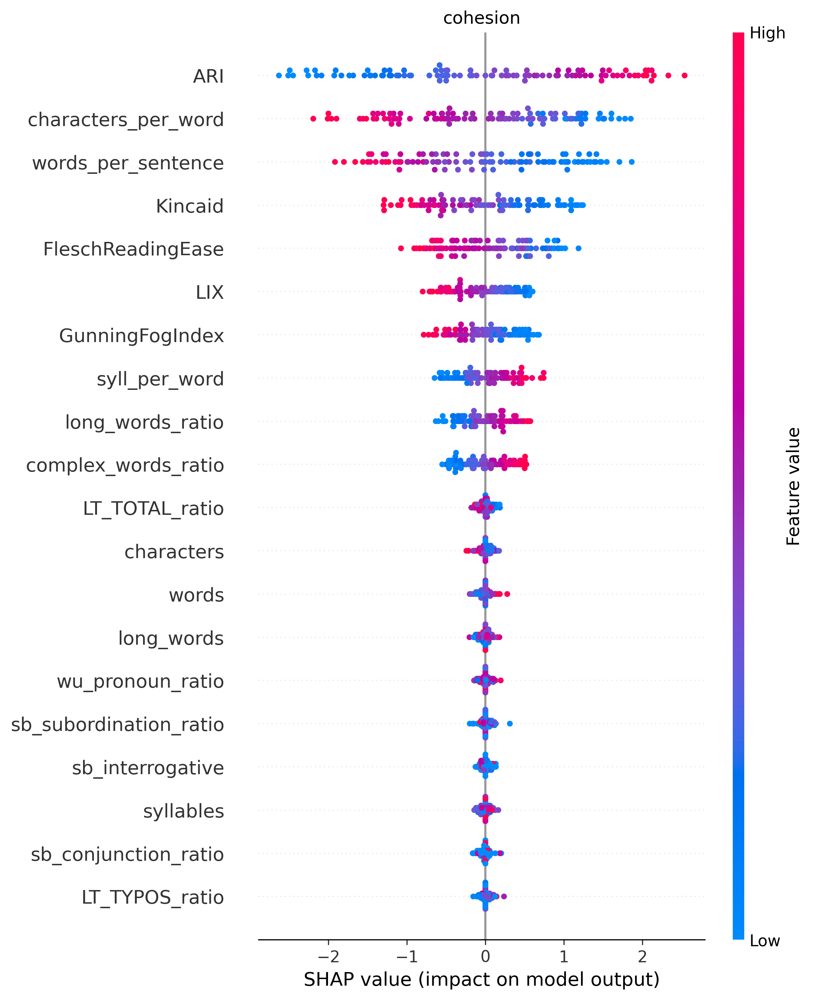

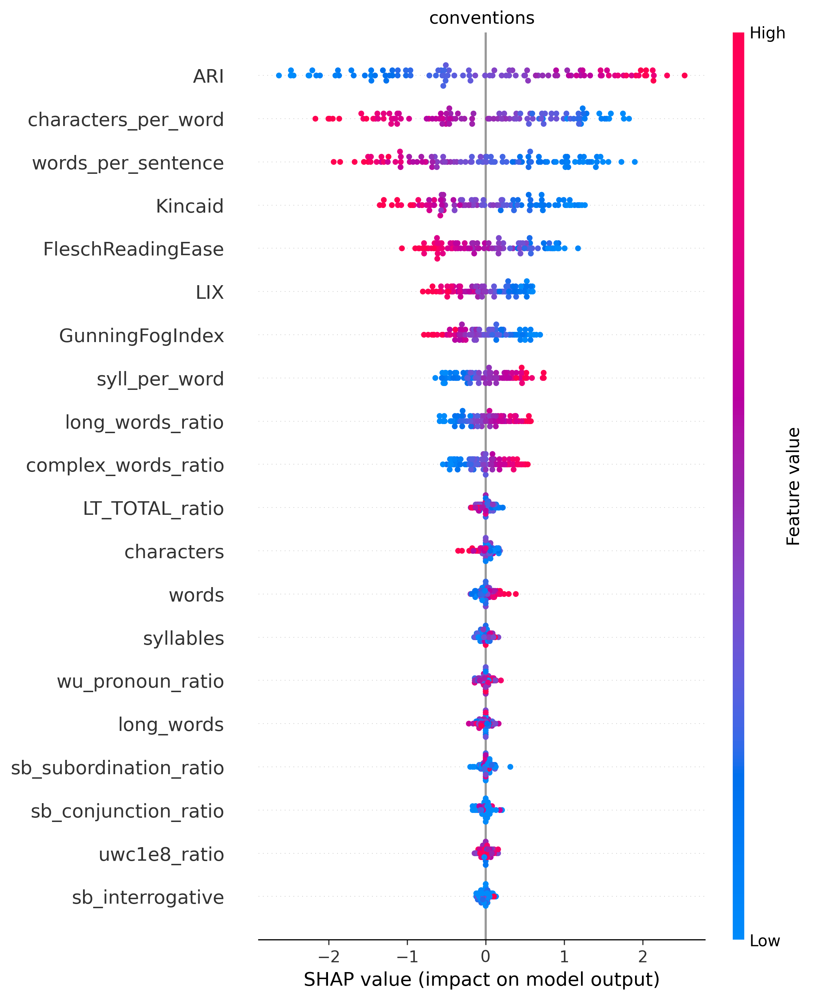

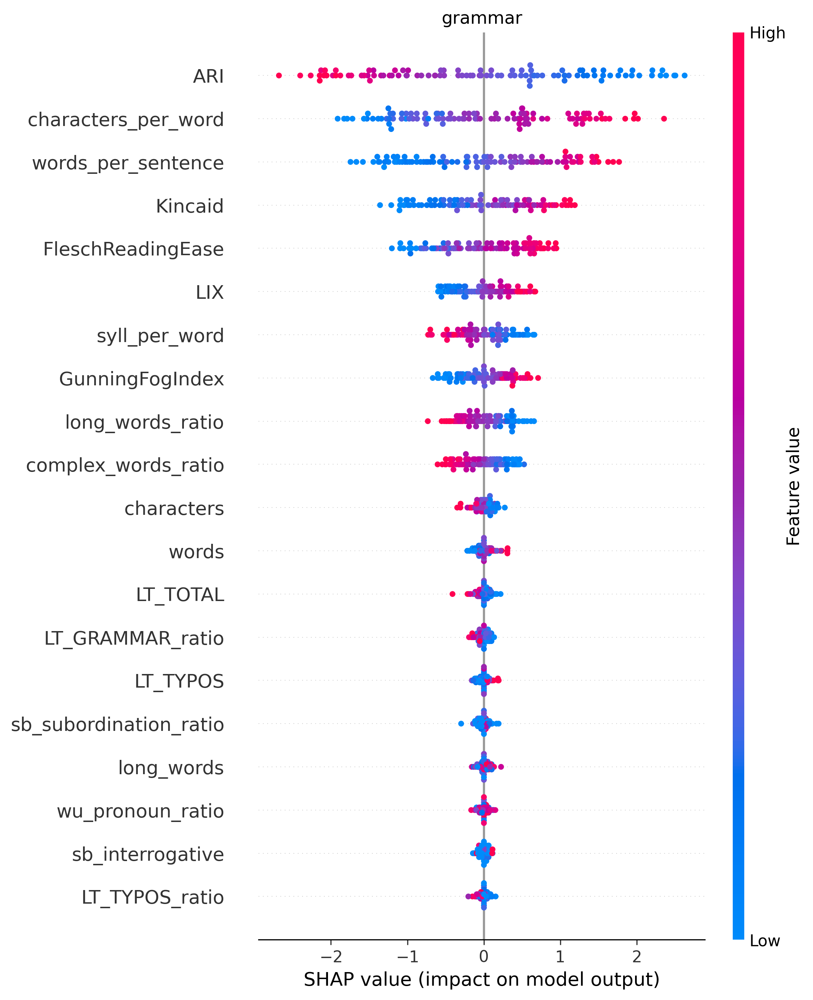

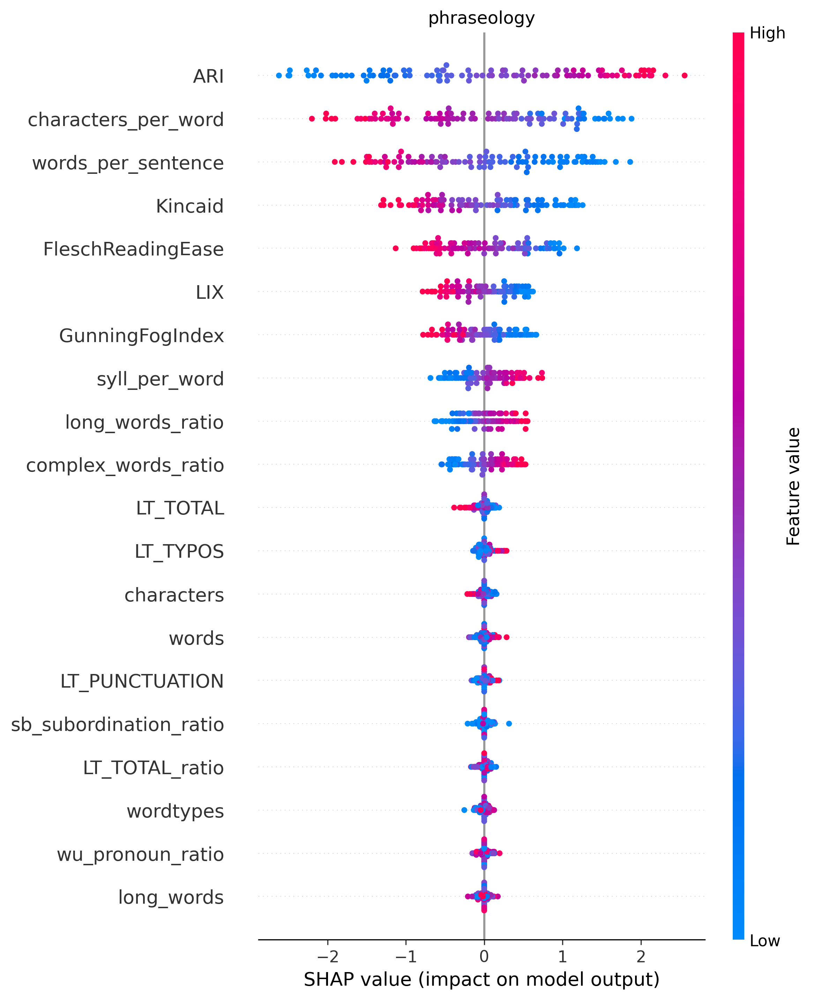

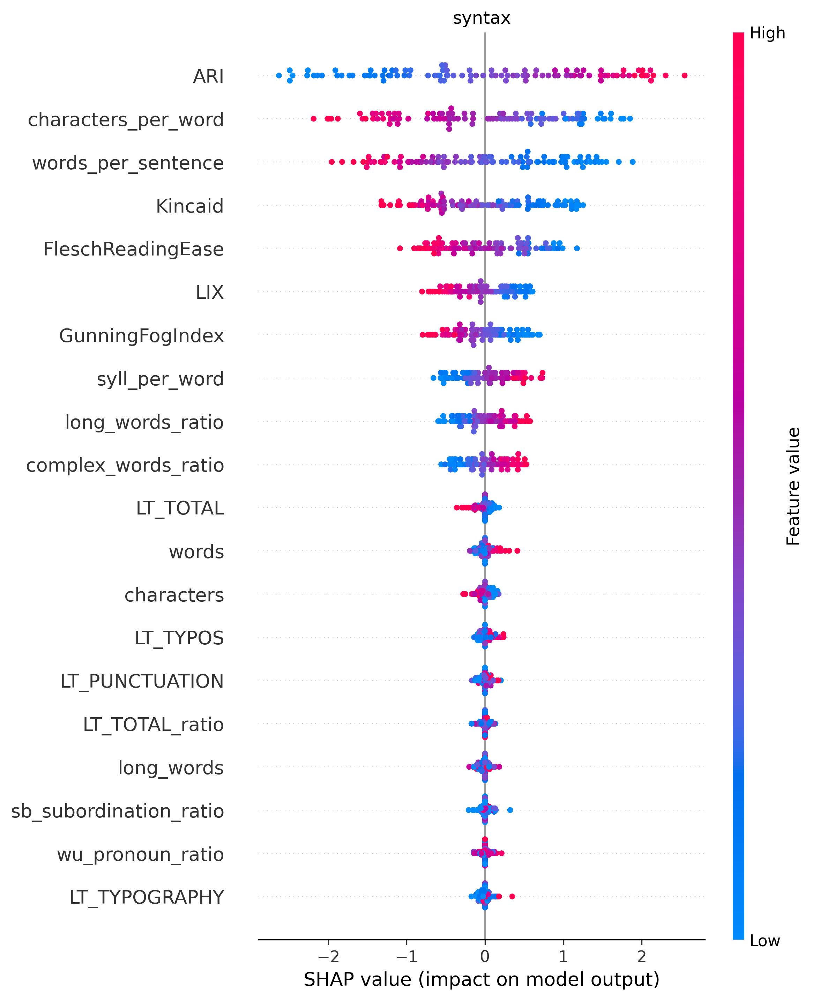

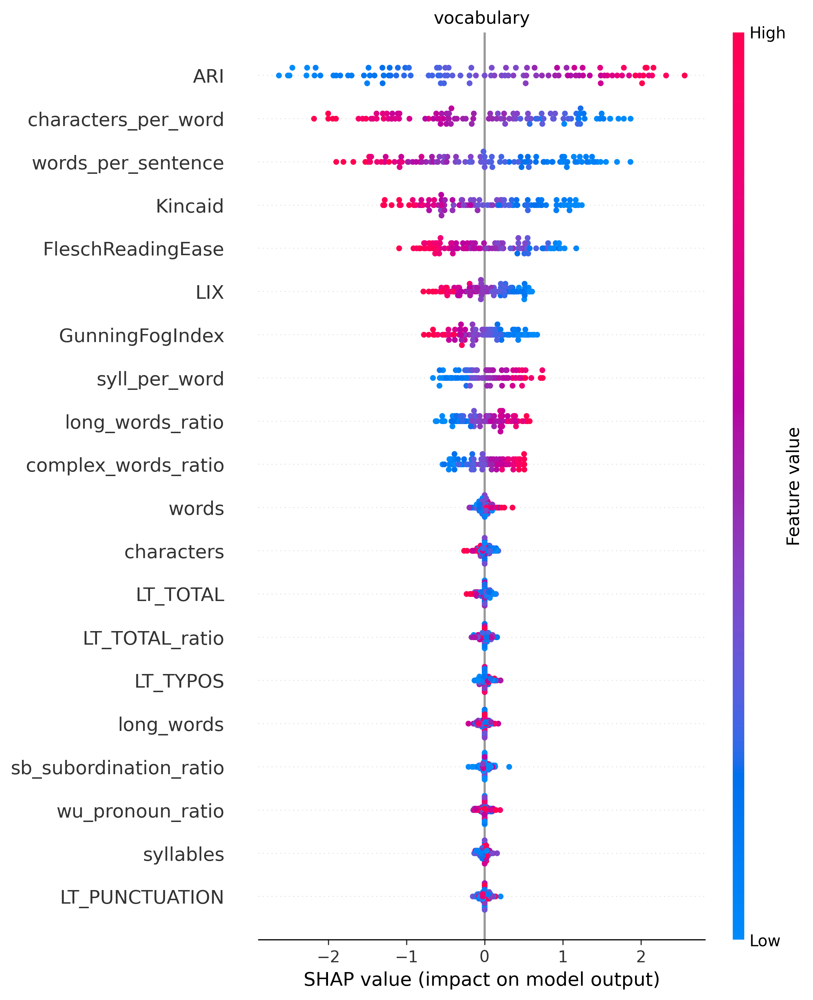

In [185]:
for i, target_name in enumerate(targets):
    shap.summary_plot(shap_values[i],
                      shap_dataset[final_model.feature_names_in_],
                      show=False
                      )
    ax = plt.gca()
    ax.set_title(target_name)
    plt.show()

As we can see, the most important feature now is ARI and the top 3 features are the same for each target. This may be because our voting model has linear regressor with highly correlated features and we may expect some issues in importance analysis from it.

In [207]:
large_df[['ARI',
          'characters_per_word',
          'words_per_sentence',
          'Kincaid',
          'FleschReadingEase',
          'LIX',
          'GunningFogIndex',
          'syll_per_word',
          'long_words_ratio',
          'complex_words_ratio',
          'words',
          'characters']].corr()

,ARI,characters_per_word,words_per_sentence,Kincaid,FleschReadingEase,LIX,GunningFogIndex,syll_per_word,long_words_ratio,complex_words_ratio,words,characters
ARI,1.000000,-0.059304,0.991195,0.996809,-0.950654,0.991447,0.991939,-0.025384,-0.060023,-0.013848,0.079803,0.069576
characters_per_word,-0.059304,1.000000,-0.190957,-0.058370,-0.170503,0.003794,-0.094101,0.859563,0.865101,0.624766,-0.073827,0.070778
words_per_sentence,0.991195,-0.190957,1.000000,0.987933,-0.912190,0.974416,0.987884,-0.138975,-0.173771,-0.096487,0.088265,0.059028
Kincaid,0.996809,-0.058370,0.987933,1.000000,-0.964648,0.990688,0.993566,0.016079,-0.048854,0.017570,0.082203,0.072297
FleschReadingEase,-0.950654,-0.170503,-0.912190,-0.964648,1.000000,-0.963014,-0.947709,-0.279020,-0.166435,-0.210667,-0.067296,-0.090836
LIX,0.991447,0.003794,0.974416,0.990688,-0.963014,1.000000,0.986072,0.043808,0.052009,0.056455,0.073808,0.072552
GunningFogIndex,0.991939,-0.094101,0.987884,0.993566,-0.947709,0.986072,1.000000,-0.024742,-0.068863,0.059152,0.082974,0.067731
syll_per_word,-0.025384,0.859563,-0.138975,0.016079,-0.279020,0.043808,-0.024742,1.000000,0.809459,0.735241,-0.044212,0.081193
long_words_ratio,-0.060023,0.865101,-0.173771,-0.048854,-0.166435,0.052009,-0.068863,0.809459,1.000000,0.676086,-0.068787,0.055617
complex_words_ratio,-0.013848,0.624766,-0.096487,0.017570,-0.210667,0.056455,0.059152,0.735241,0.676086,1.000000,-0.035592,0.054707


Actually, we can analyze correlations for the whole set of features

In [209]:
from scipy.stats import spearmanr
from scipy.cluster import hierarchy
from scipy.spatial.distance import squareform

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(20, 60))
corr = spearmanr(large_df[features]).correlation

# Ensure the correlation matrix is symmetric
corr = (corr + corr.T) / 2
np.fill_diagonal(corr, 1)

# We convert the correlation matrix to a distance matrix before performing
# hierarchical clustering using Ward's linkage.
distance_matrix = 1 - np.abs(corr)
dist_linkage = hierarchy.ward(squareform(distance_matrix))
dendro = hierarchy.dendrogram(
    dist_linkage, labels=features, ax=ax1, orientation='right'
)
dendro_idx = np.arange(0, len(dendro["ivl"]))

ax2.imshow(corr[dendro["leaves"], :][:, dendro["leaves"]])
ax2.set_xticks(dendro_idx)
ax2.set_yticks(dendro_idx)
ax2.set_xticklabels(dendro["ivl"], rotation="vertical")
ax2.set_yticklabels(dendro["ivl"])
fig.tight_layout()
plt.show()

As you can see, there are clusters of highly correlated features! Such as (syllables, characters, words, text_len), (LT_REDUNDANCY, LT_REDUNDANCY_ratio), (Kincaid, ARI, GunningFogIndex, words_per_sentence), (uwc1e5, uwc1e5_ratio), (type_token_ratio, wordtypes_ratio) and so on

Now let's try SHAP analysis on our xgb regressor

In [191]:
explainer_xgb_only = shap.TreeExplainer(xgb_reg)

In [195]:
shap_values_xgb_only = explainer_xgb_only.shap_values(large_df[xgb_reg.feature_names_in_])

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


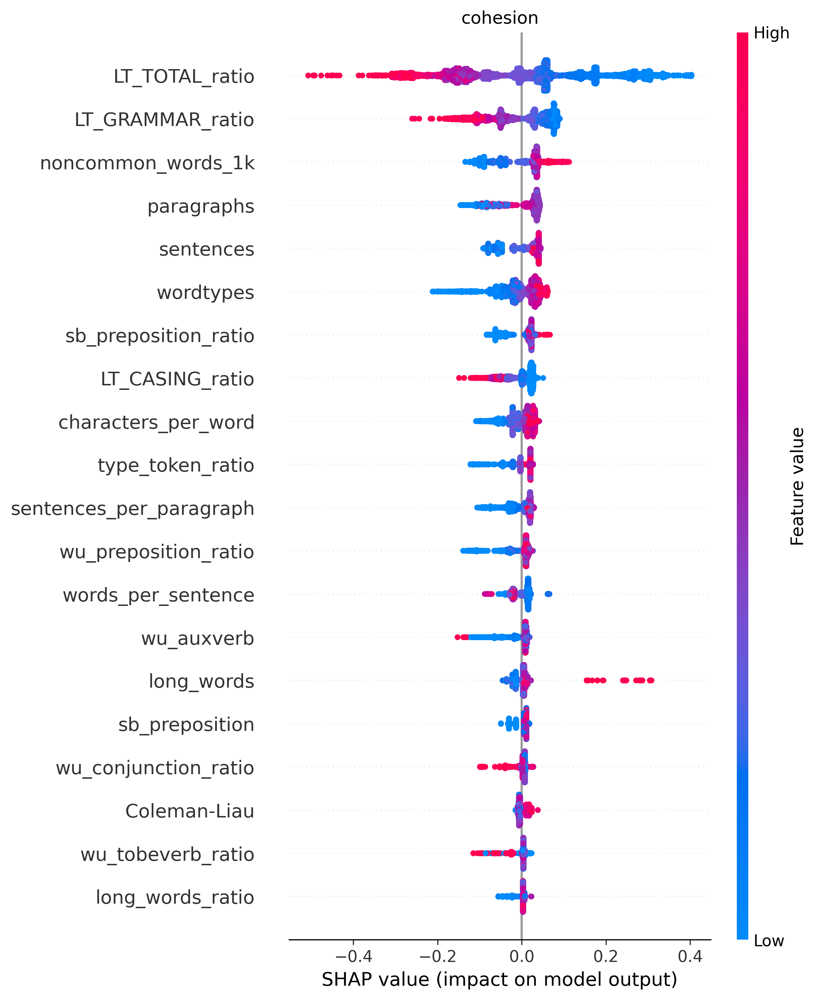

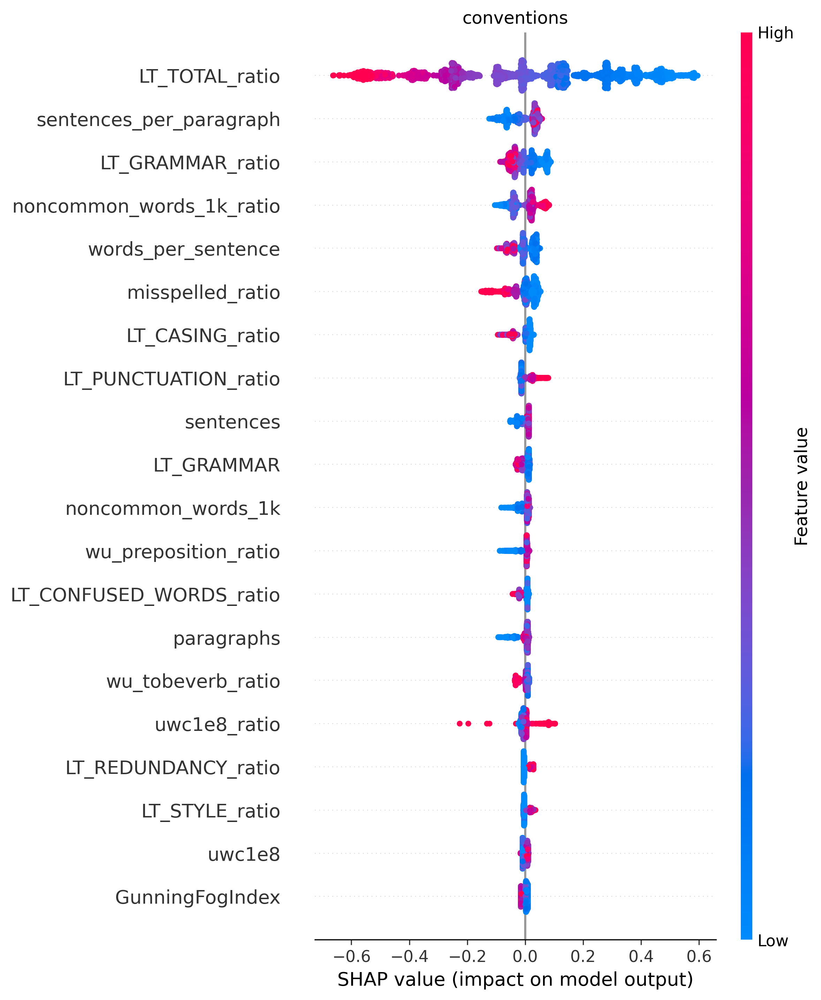

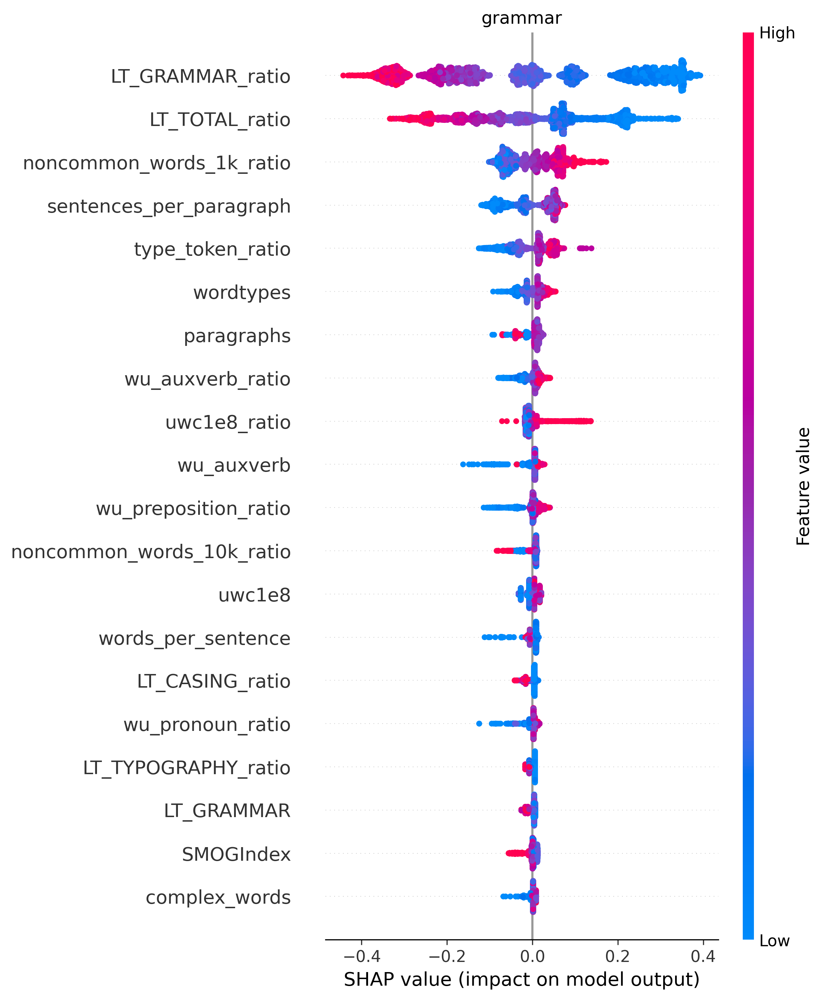

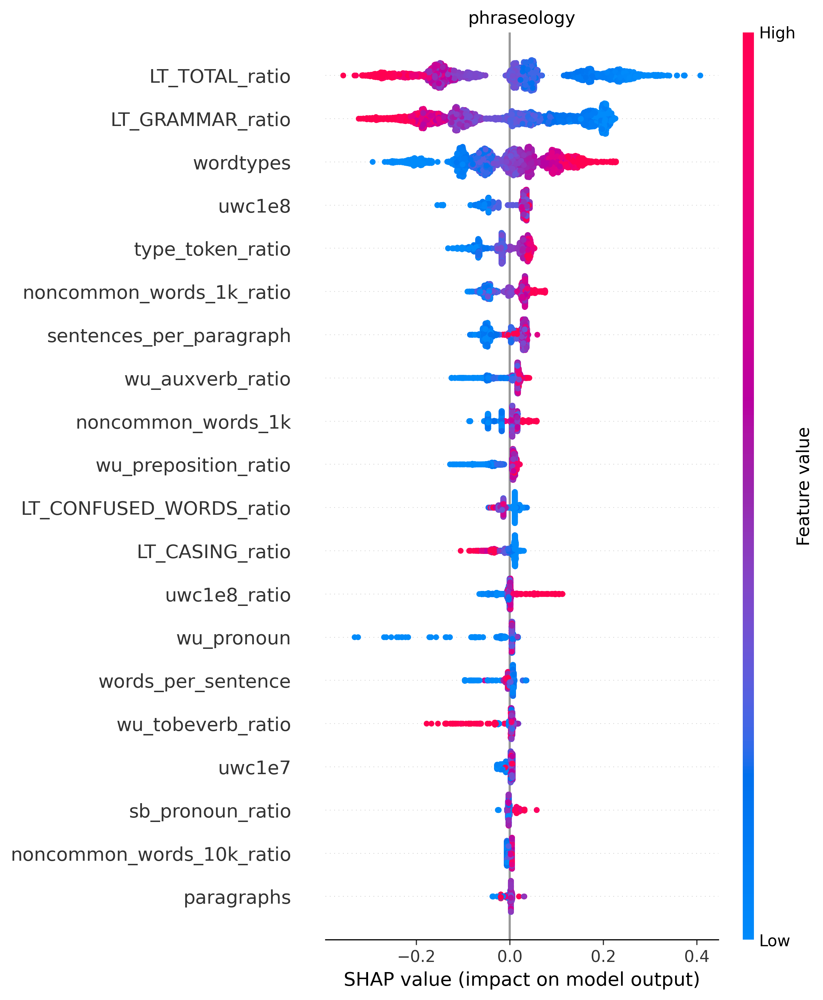

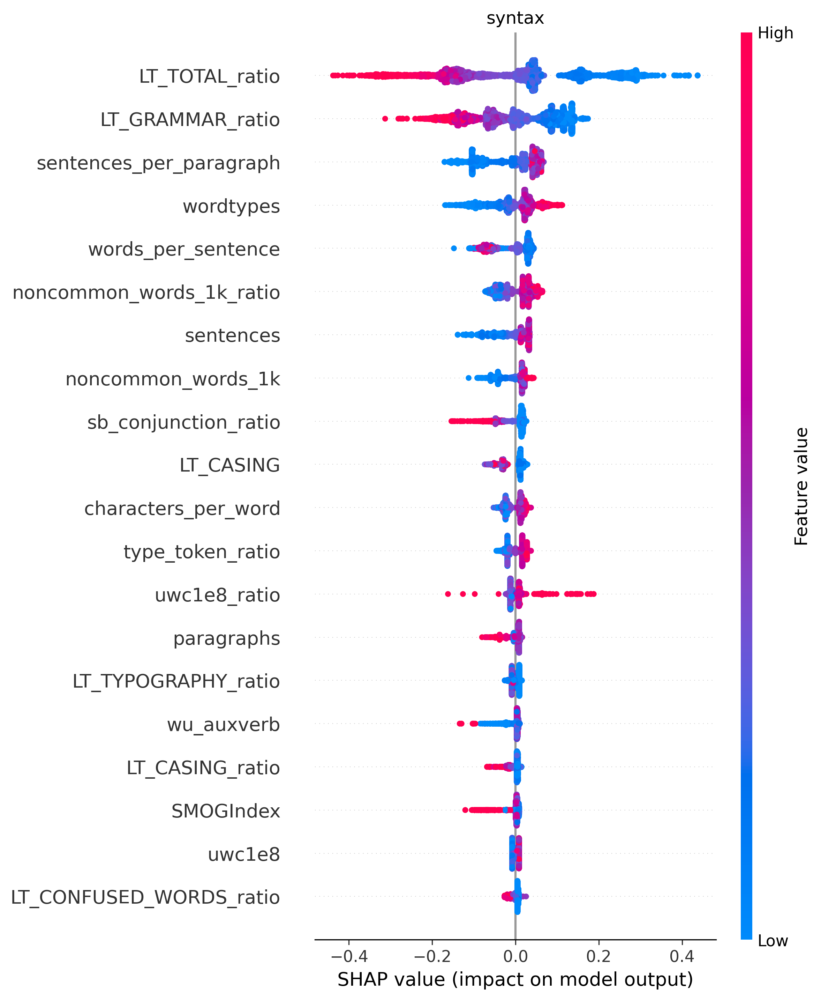

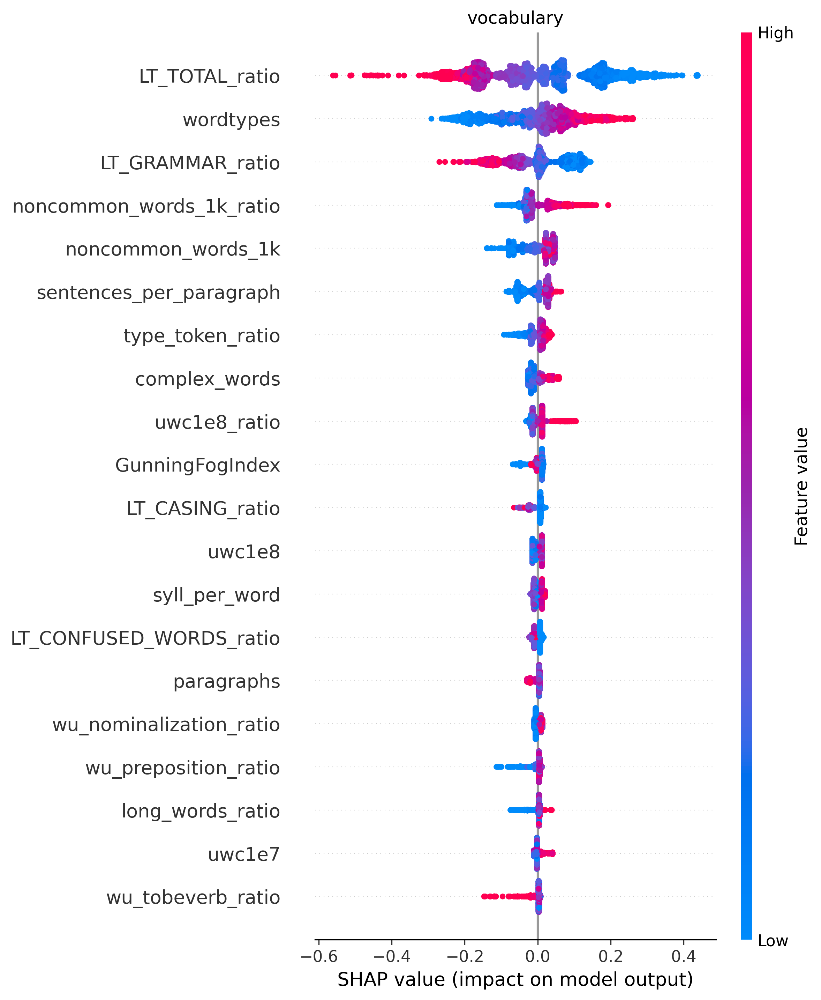

In [196]:
for i, target_name in enumerate(targets):
    shap.summary_plot(shap_values_xgb_only[i],
                      large_df[xgb_reg.feature_names_in_],
                      show=False
                      )
    ax = plt.gca()
    ax.set_title(target_name)
    plt.show()

## They look much more reasonable
For example, for grammar, the top feature is LT_GRAMMAR_ratio.

For vocabulary, the second top feature is wordtypes (number of different word types).

Besides, it looks pretty close to the top features by weight and gain
